## 1. Install packages, GPU and Seed

In [2]:
# Standard libraries
import h5py
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from matplotlib.colors import ListedColormap
import matplotlib.colors as colors
import numpy as np
import pandas as pd
import random
import os
import pickle
import gc
from collections import Counter

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader


# Sklearn
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split

# Custom
from cust_functions.processing_helper import *
from cust_functions.models import *
from cust_functions.training_helper import *
from cust_functions.datavis_helper import *

In [3]:
print("Torch CUDA available:", torch.cuda.is_available())
print("Number of GPUs:", torch.cuda.device_count())
print("Current GPU:", torch.cuda.current_device())
print("GPU Name:", torch.cuda.get_device_name(torch.cuda.current_device()))

Torch CUDA available: True
Number of GPUs: 2
Current GPU: 0
GPU Name: NVIDIA GeForce GTX 1080 Ti


In [4]:
"""
Define seed
"""

SEED = 42

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)
torch.backends.cudnn.deterministic = False
torch.backends.cudnn.benchmark = False

## 2. Validation

In [10]:
directory = "/home"
base_path = f"{directory}/pf/pfstud/mlarriere/aligned_data/"
dw_path = f"{directory}/pf/pfstud/mlarriere/DW_files/DW_timeslices/"

tile_lengths = {'tile0': 36, 'tile1': 26, 'tile3': 16, 'tile4': 22}
tiles = [0, 1, 3, 4]

# create files for all h5 image tiles
tile0 = [f"{base_path}tile0_aligned_{timestep}.h5" for timestep in range(0, tile_lengths['tile0'])]
tile1 = [f"{base_path}tile1_aligned_{timestep}.h5" for timestep in range(0, tile_lengths['tile1'])]
tile3 = [f"{base_path}tile3_aligned_{timestep}.h5" for timestep in range(0, tile_lengths['tile3'])]
tile4 = [f"{base_path}tile4_aligned_{timestep}.h5" for timestep in range(0, tile_lengths['tile4'])]
h5_files = tile0 + tile1 + tile3 + tile4

# create files for all h5 land cover tiles
dw_tile0 = [f"{dw_path}scaled_cloudy_tile_0_dw_{timestep}.h5" for timestep in range(0, tile_lengths['tile0'])]
dw_tile1 = [f"{dw_path}scaled_cloudy_tile_1_dw_{timestep}.h5" for timestep in range(0, tile_lengths['tile1'])]
dw_tile3 = [f"{dw_path}scaled_cloudy_tile_3_dw_{timestep}.h5" for timestep in range(0, tile_lengths['tile3'])]
dw_tile4 = [f"{dw_path}scaled_cloudy_tile_4_dw_{timestep}.h5" for timestep in range(0, tile_lengths['tile4'])]
dw_files_scaled_cloudy = dw_tile0 + dw_tile1 + dw_tile3 + dw_tile4

In [12]:
file_names = {'CLD': 'CLD', 'RGB': 'RGB', 'NIR': 'NIR'}
dw_file_name = 'DW_cloudy'
cld_threshold = 1.0

dataset_no_fusion_128 = H5Dataset(h5_files, dw_files_scaled_cloudy, file_name = file_names, dw_file_name=dw_file_name, patch_size=(128, 128), cloud_threshold = 1.0, augment=False, num_augment=1)
dataset_no_fusion_256 = H5Dataset(h5_files, dw_files_scaled_cloudy, file_name = file_names, dw_file_name=dw_file_name, patch_size=(256, 256), cloud_threshold = 1.0, augment=False, num_augment=1)
dataset_earlyfusion_256_3 = H5Dataset_early(h5_files, dw_files_scaled_cloudy, file_name = file_names, dw_file_name=dw_file_name, patch_size=(256, 256), cloud_threshold = 1.0, 
                         calculate_time_slice_indices=False, time_file_name='precomputed_indices/time_slice_indices_precomputed_256_early3.pkl', timesteps=3)
dataset_earlyfusion_256_5 = H5Dataset_early(h5_files, dw_files_scaled_cloudy, file_name = file_names, dw_file_name=dw_file_name, patch_size=(256, 256), cloud_threshold = 1.0, 
                        calculate_time_slice_indices=False, time_file_name='precomputed_indices/time_slice_indices_precomputed_256_early5.pkl', timesteps=5)
dataset_fusion_score3 = H5Dataset_score(h5_files, dw_files_scaled_cloudy, file_name = file_names, dw_file_name=dw_file_name, patch_size=(256, 256), cloud_threshold = 1.0, 
                                calculate_time_slice_indices=False, timesteps = 3, time_file_name = 'precomputed_indices/time_slice_indices_precomputed_256_score3.pkl')
dataset_fusion_score5 = H5Dataset_score(h5_files, dw_files_scaled_cloudy, file_name = file_names, dw_file_name=dw_file_name, patch_size=(256, 256), cloud_threshold = 1.0, 
                                calculate_time_slice_indices=False, timesteps = 5, time_file_name = 'precomputed_indices/time_slice_indices_precomputed_256_score5.pkl')

In [13]:
# Load preprocessed validation datasets
with open('precomputed_indices/val_indices_128.pkl', 'rb') as f:
    val_indices_128 = pickle.load(f)

with open('precomputed_indices/val_indices_256.pkl', 'rb') as f:
    val_indices_256 = pickle.load(f)

preprocessed_val_dataset_256 = PreprocessedValDataset('/home/pf/pfstud/mlarriere/preprocessed_val_data_256')
preprocessed_val_dataset_256_early3 = PreprocessedValDataset('/home/pf/pfstud/mlarriere/preprocessed_val_data_256_early3')
preprocessed_val_dataset_256_early5 = PreprocessedValDataset('/home/pf/pfstud/mlarriere/preprocessed_val_data_256_early5')
preprocessed_val_dataset_128 = PreprocessedValDataset('/home/pf/pfstud/mlarriere/preprocessed_val_data_128')
preprocessed_val_dataset_256_score3 = PreprocessedValDataset('/home/pf/pfstud/mlarriere/preprocessed_val_data_256_score3')
preprocessed_val_dataset_256_score5 = PreprocessedValDataset('/home/pf/pfstud/mlarriere/preprocessed_val_data_256_score5')

### 2.0 Baseline

In [ ]:
file_names = {'CLD': 'CLD', 'RGB': 'RGB', 'NIR': 'NIR'}
dw_file_name = 'DW_cloudy'
cld_threshold = 1.0

dataset_seperated_128 = H5Dataset(h5_files, dw_files_scaled_cloudy, file_name=file_names, dw_file_name=dw_file_name ,patch_size=(128, 128), cloud_threshold = cld_threshold, return_rgb_nir_separately=True, augment=False, num_augment=1)
dataset_separated = H5Dataset(h5_files, dw_files_scaled_cloudy, file_name=file_names, dw_file_name=dw_file_name ,patch_size=(256, 256), cloud_threshold = cld_threshold, return_rgb_nir_separately=True, augment=False, num_augment=1)
dataset_separated = torch.utils.data.Subset(dataset_separated, val_indices_256)
dataset_seperated_128 = torch.utils.data.Subset(dataset_seperated_128, val_indices_128)

#### 2.0.1 256x256 patches

In [ ]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 4 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 64
val_dataloader = DataLoader(preprocessed_val_dataset_256, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.31
PATH = f"saved_models/BaselineCNN_bestf1_{saved_f1}.pth"

# load model
model = load_model(Unet_DW_baseline, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store validation results
val_results = {
    "best_val_accuracy": 0.0,
    "best_val_f1_score": 0.0,
    "best_val_recall": 0.0,
    "best_val_precision": 0.0,
}

best_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Validate model
_, running_val_confusion_matrix = validate_model(model, criterion, val_dataloader, device, NUM_CLASSES, class_labels)
running_val_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_val_confusion_matrix, exlude_classes)

# Update best f1 scores per class
val_precision, val_recall, val_f1_score = calculate_metrics(running_val_confusion_matrix_reduced)

for i, f1 in enumerate(val_f1_score):
    best_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
val_precision_avg = val_precision.mean()
val_recall_avg = val_recall.mean()
val_f1_score_avg = val_f1_score.mean()
val_accuracy = running_val_confusion_matrix_reduced.trace() / running_val_confusion_matrix.sum()

# Update results lists
val_results["best_val_accuracy"] = val_accuracy
val_results["best_val_precision"] = val_precision_avg
val_results["best_val_recall"] = val_recall_avg
val_results["best_val_f1_score"] = val_f1_score_avg


cuda


Best validation accuracy: 0.5815
Best averaged validation precision: 0.3824
Best averaged validation recall: 0.3285
Best averaged validation f1 score: 0.3110
Best validation f1 score - class 01: 0.5610 (trees)
Best validation f1 score - class 02: 0.0000 (grass)
Best validation f1 score - class 03: 0.0034 (flooded veg.)
Best validation f1 score - class 04: 0.1356 (crops)
Best validation f1 score - class 05: 0.7953 (shrub & scrub)
Best validation f1 score - class 06: 0.0000 (built-up)
Best validation f1 score - class 07: 0.0000 (bare)
Best validation f1 score - class 09: 0.9925 (water)
Confusion matrix for all relevant classes


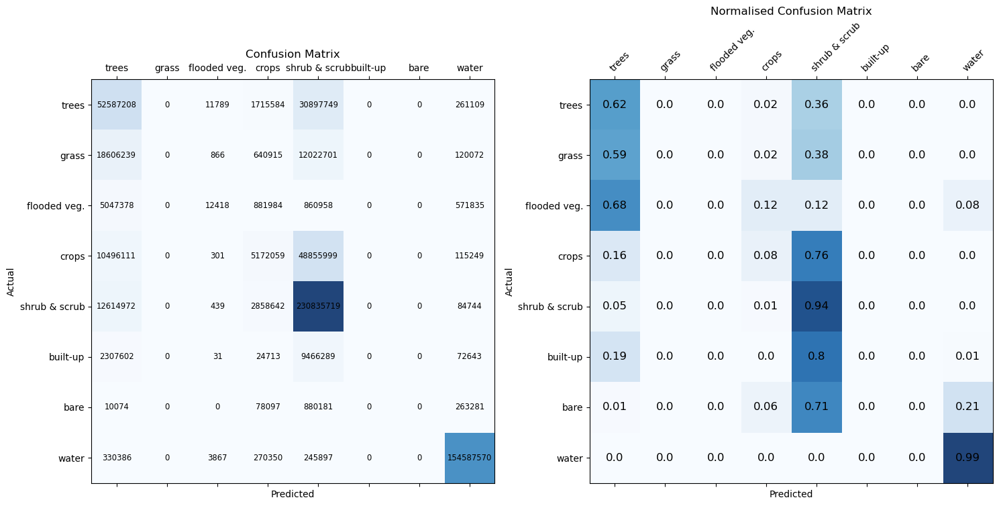

Confusion matrix for all classes


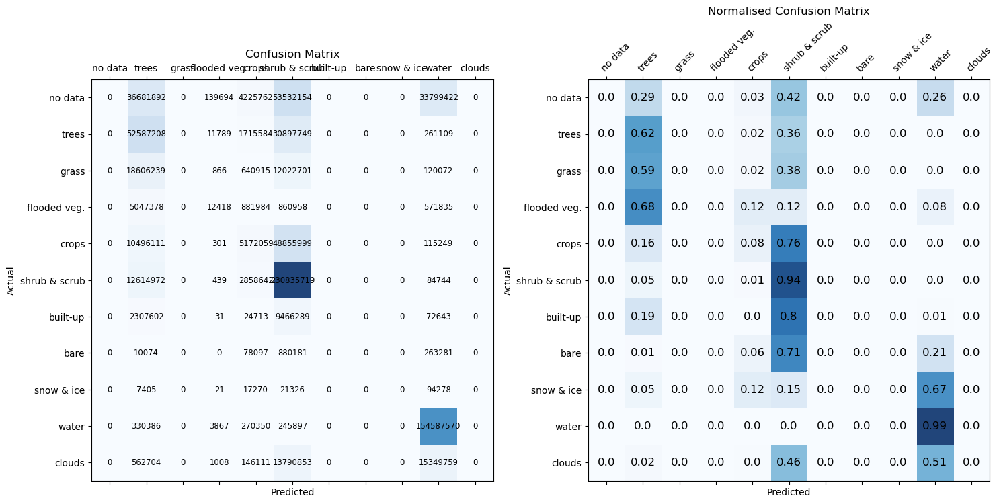

In [34]:
# Print best model metrics
print(f"Best validation accuracy: {val_results['best_val_accuracy']:.4f}")
print(f"Best averaged validation precision: {val_results['best_val_precision']:.4f}")
print(f"Best averaged validation recall: {val_results['best_val_recall']:.4f}")
print(f"Best averaged validation f1 score: {val_results['best_val_f1_score']:.4f}")

print(f"Best validation f1 score - class 01: {best_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Best validation f1 score - class 02: {best_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Best validation f1 score - class 03: {best_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Best validation f1 score - class 04: {best_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Best validation f1 score - class 05: {best_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Best validation f1 score - class 06: {best_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Best validation f1 score - class 07: {best_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Best validation f1 score - class 09: {best_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix, labels_all)

cuda


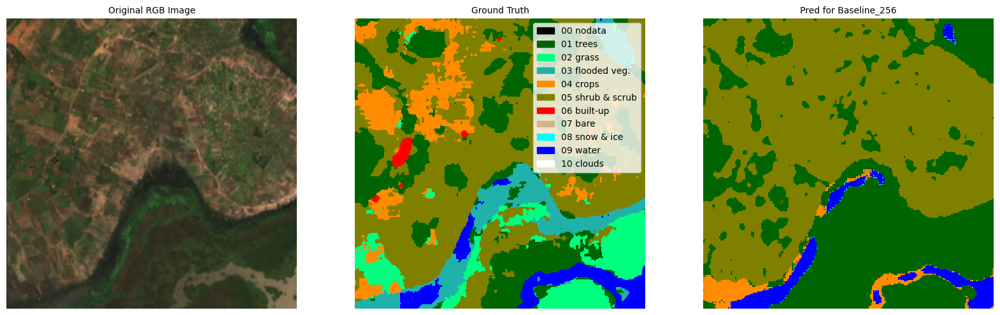

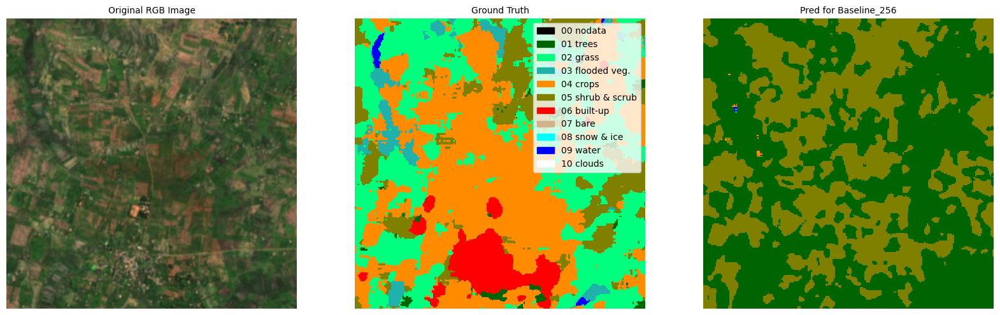

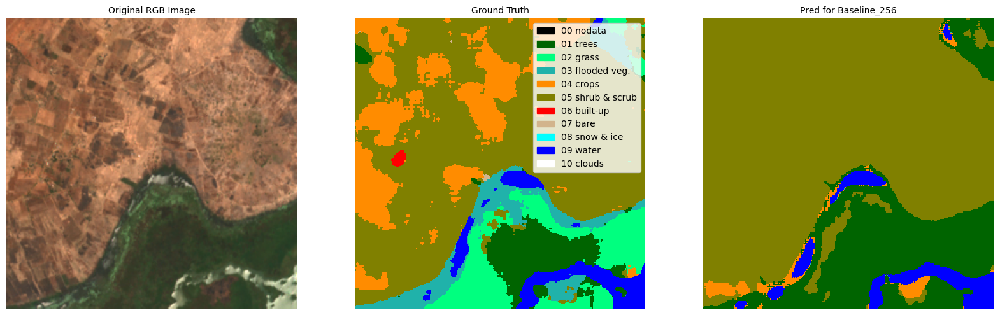

In [19]:
dataset_for_prediction = torch.utils.data.Subset(dataset_no_fusion_256, val_indices_256)

# Plot prediction and ground truth overlayed on rgb image
for i in [1588, 10796, 1604]:
    rgb = dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = dataset_for_prediction[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, dataset_for_prediction, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['Baseline_256'])

#### 4.0.2 128x128 patches

In [30]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 4 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 64
val_dataloader = DataLoader(preprocessed_val_dataset_128, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.45
PATH = f"saved_models/BaselineCNN_128_bestf1_{saved_f1}.pth"

# load model
model = load_model(Unet_DW_baseline, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store validation results
val_results = {
    "best_val_accuracy": 0.0,
    "best_val_f1_score": 0.0,
    "best_val_recall": 0.0,
    "best_val_precision": 0.0,
}

best_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Validate model
_, running_val_confusion_matrix = validate_model(model, criterion, val_dataloader, device, NUM_CLASSES, class_labels)
running_val_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_val_confusion_matrix, exlude_classes)

# Update best f1 scores per class
val_precision, val_recall, val_f1_score = calculate_metrics(running_val_confusion_matrix_reduced)

for i, f1 in enumerate(val_f1_score):
    best_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
val_precision_avg = val_precision.mean()
val_recall_avg = val_recall.mean()
val_f1_score_avg = val_f1_score.mean()
val_accuracy = running_val_confusion_matrix_reduced.trace() / running_val_confusion_matrix.sum()

# Update results lists
val_results["best_val_accuracy"] = val_accuracy
val_results["best_val_precision"] = val_precision_avg
val_results["best_val_recall"] = val_recall_avg
val_results["best_val_f1_score"] = val_f1_score_avg


cuda


Best validation accuracy: 0.5638
Best averaged validation precision: 0.5605
Best averaged validation recall: 0.4518
Best averaged validation f1 score: 0.4458
Best validation f1 score - class 01: 0.5950 (trees)
Best validation f1 score - class 02: 0.2501 (grass)
Best validation f1 score - class 03: 0.3533 (flooded veg.)
Best validation f1 score - class 04: 0.1054 (crops)
Best validation f1 score - class 05: 0.7763 (shrub & scrub)
Best validation f1 score - class 06: 0.4986 (built-up)
Best validation f1 score - class 07: 0.0005 (bare)
Best validation f1 score - class 09: 0.9870 (water)
Confusion matrix for all relevant classes


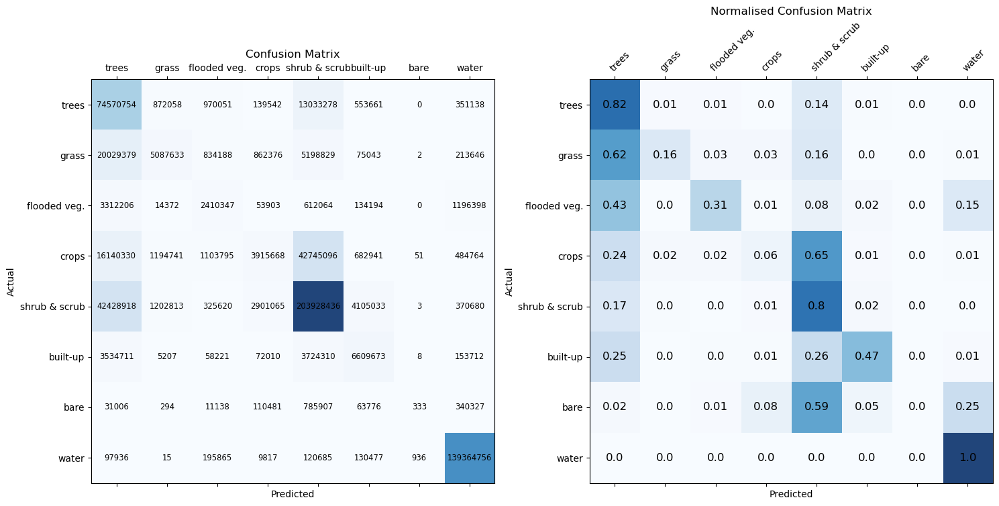

Confusion matrix for all classes


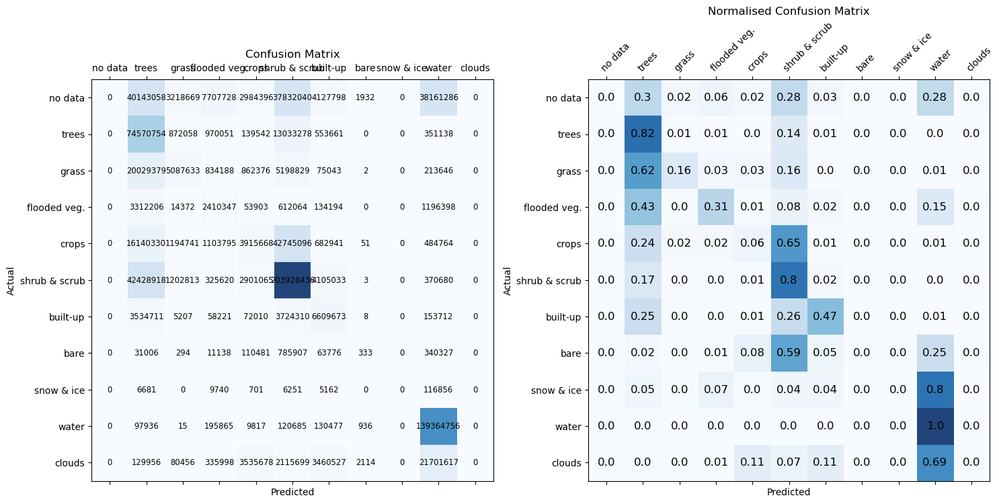

In [31]:
# Print best model metrics
print(f"Best validation accuracy: {val_results['best_val_accuracy']:.4f}")
print(f"Best averaged validation precision: {val_results['best_val_precision']:.4f}")
print(f"Best averaged validation recall: {val_results['best_val_recall']:.4f}")
print(f"Best averaged validation f1 score: {val_results['best_val_f1_score']:.4f}")

print(f"Best validation f1 score - class 01: {best_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Best validation f1 score - class 02: {best_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Best validation f1 score - class 03: {best_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Best validation f1 score - class 04: {best_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Best validation f1 score - class 05: {best_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Best validation f1 score - class 06: {best_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Best validation f1 score - class 07: {best_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Best validation f1 score - class 09: {best_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix, labels_all)

cuda


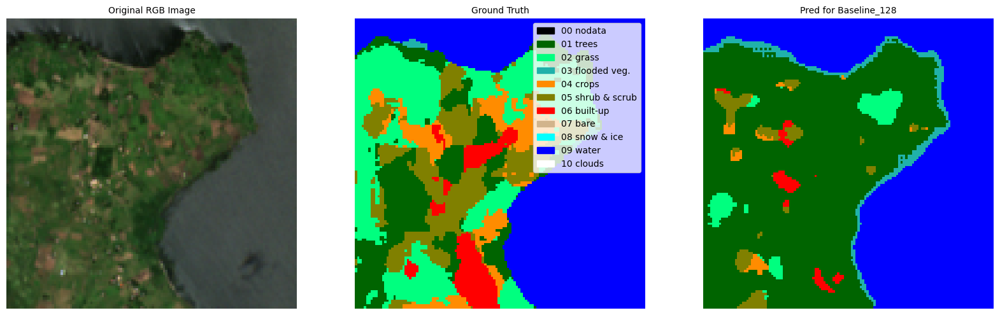

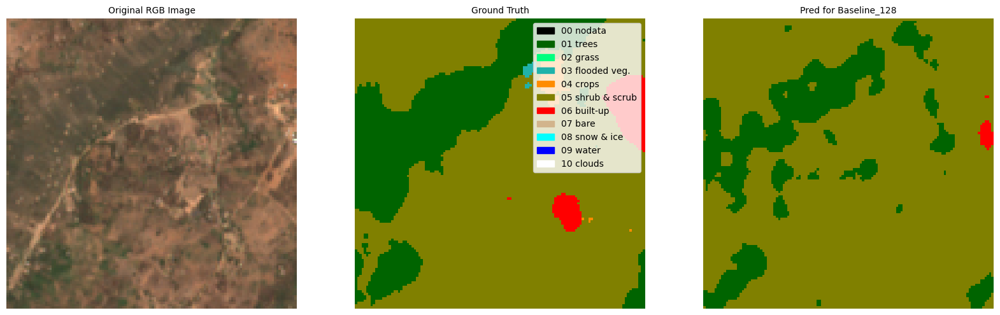

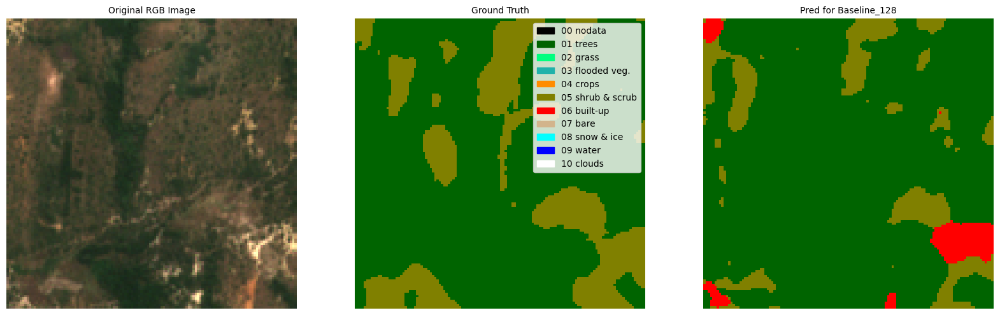

In [20]:
dataset_for_prediction = torch.utils.data.Subset(dataset_no_fusion_128, val_indices_128)

# Plot prediction and ground truth overlayed on rgb image
for i in [1510, 9024, 3001]:
    rgb = dataset_seperated_128[i][0].permute(1, 2, 0).numpy()
    truth = dataset_for_prediction[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, dataset_for_prediction, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['Baseline_128'])

### 4.1 No fusion model

#### 4.1.1 With 256x256 patches

In [24]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 4 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 64
val_dataloader = DataLoader(preprocessed_val_dataset_256, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.58
PATH = f"saved_models/NoFusionCNN_bestf1_{saved_f1}.pth"

# load model
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store validation results
val_results = {
    "best_val_accuracy": 0.0,
    "best_val_f1_score": 0.0,
    "best_val_recall": 0.0,
    "best_val_precision": 0.0,
}

best_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Validate model
_, running_val_confusion_matrix = validate_model(model, criterion, val_dataloader, device, NUM_CLASSES, class_labels)
running_val_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_val_confusion_matrix, exlude_classes)

# Update best f1 scores per class
val_precision, val_recall, val_f1_score = calculate_metrics(running_val_confusion_matrix_reduced)

for i, f1 in enumerate(val_f1_score):
    best_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
val_precision_avg = val_precision.mean()
val_recall_avg = val_recall.mean()
val_f1_score_avg = val_f1_score.mean()
val_accuracy = running_val_confusion_matrix_reduced.trace() / running_val_confusion_matrix.sum()

# Update results lists
val_results["best_val_accuracy"] = val_accuracy
val_results["best_val_precision"] = val_precision_avg
val_results["best_val_recall"] = val_recall_avg
val_results["best_val_f1_score"] = val_f1_score_avg


cuda


Plots of metrics

Best validation accuracy: 0.6212
Best averaged validation precision: 0.6899
Best averaged validation recall: 0.5588
Best averaged validation f1 score: 0.5772
Best validation f1 score - class 01: 0.6597 (trees)
Best validation f1 score - class 02: 0.5406 (grass)
Best validation f1 score - class 03: 0.5877 (flooded veg.)
Best validation f1 score - class 04: 0.2637 (crops)
Best validation f1 score - class 05: 0.8208 (shrub & scrub)
Best validation f1 score - class 06: 0.6108 (built-up)
Best validation f1 score - class 07: 0.1377 (bare)
Best validation f1 score - class 09: 0.9966 (water)
Confusion matrix for all relevant classes


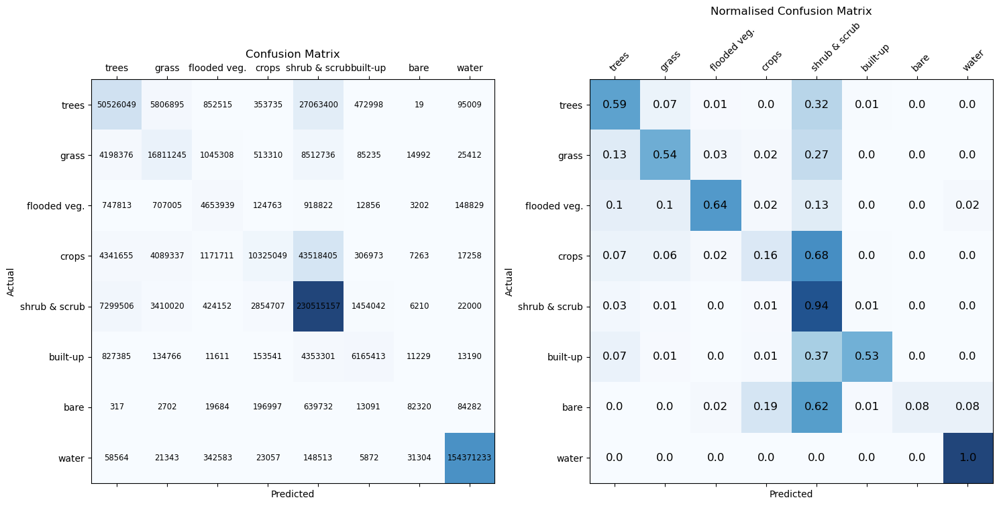

Confusion matrix for all classes


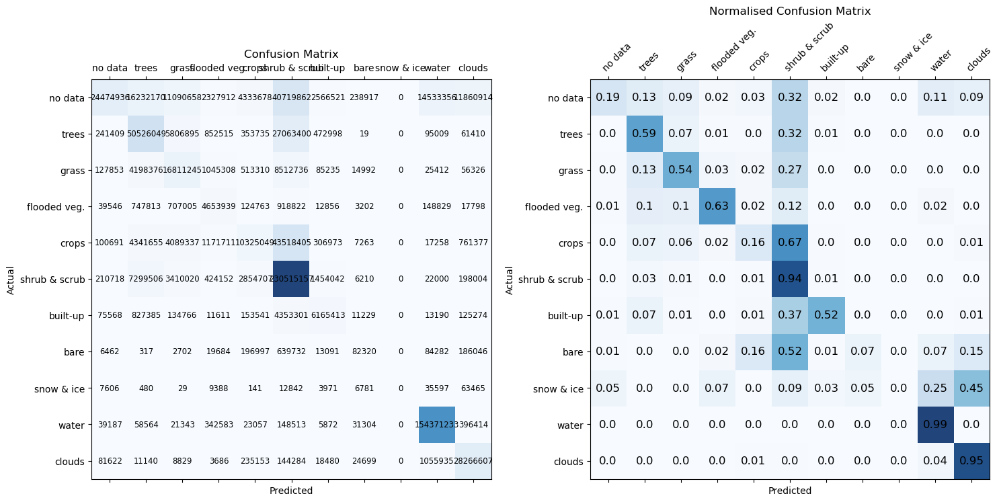

In [25]:
# Print best model metrics
print(f"Best validation accuracy: {val_results['best_val_accuracy']:.4f}")
print(f"Best averaged validation precision: {val_results['best_val_precision']:.4f}")
print(f"Best averaged validation recall: {val_results['best_val_recall']:.4f}")
print(f"Best averaged validation f1 score: {val_results['best_val_f1_score']:.4f}")

print(f"Best validation f1 score - class 01: {best_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Best validation f1 score - class 02: {best_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Best validation f1 score - class 03: {best_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Best validation f1 score - class 04: {best_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Best validation f1 score - class 05: {best_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Best validation f1 score - class 06: {best_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Best validation f1 score - class 07: {best_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Best validation f1 score - class 09: {best_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix, labels_all)

Plots of image patches

cuda


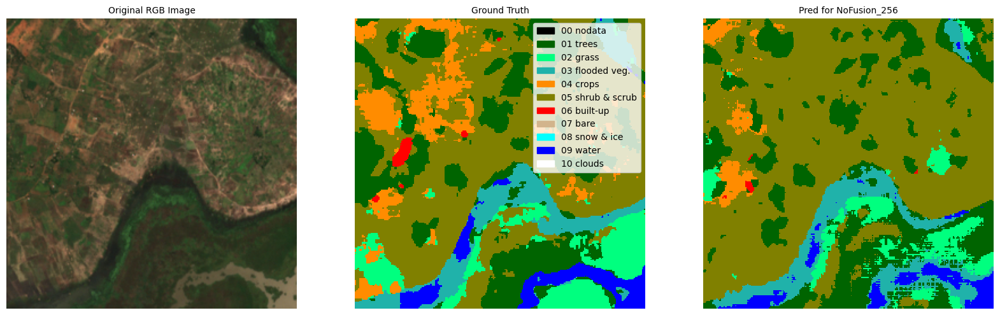

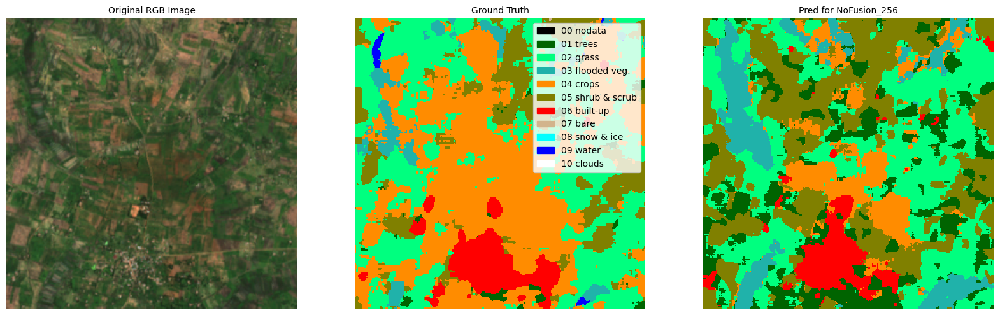

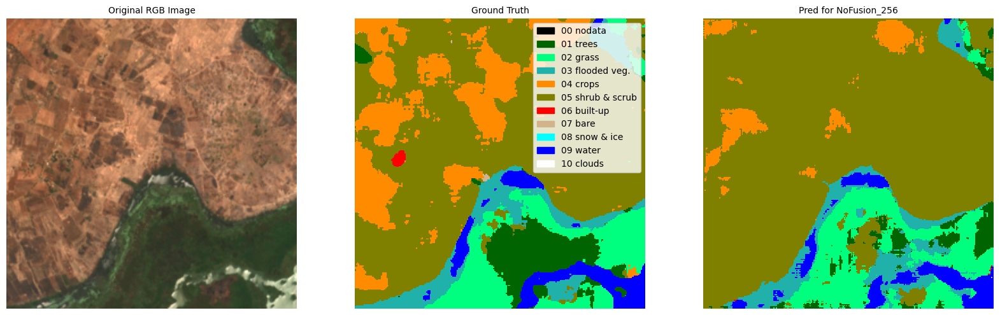

In [21]:
dataset_for_prediction = torch.utils.data.Subset(dataset_no_fusion_256, val_indices_256)

# Plot prediction and ground truth overlayed on rgb image
for i in [1588, 10796, 1604]:
    rgb = dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = dataset_for_prediction[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, dataset_for_prediction, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['NoFusion_256'])

#### 4.1.2 With 256x256 patches Weighted

In [51]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 4 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 64
val_dataloader = DataLoader(preprocessed_val_dataset_256, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 3.0, 0.5, 1.5, 5.0, 0.05, 1.0, 0.25]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.58
PATH = f"saved_models/NoFusionCNN_weighted_bestf1_{saved_f1}.pth"

# load model
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store validation results
val_results = {
    "best_val_accuracy": 0.0,
    "best_val_f1_score": 0.0,
    "best_val_recall": 0.0,
    "best_val_precision": 0.0,
}

best_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Validate model
_, running_val_confusion_matrix = validate_model(model, criterion, val_dataloader, device, NUM_CLASSES, class_labels)
running_val_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_val_confusion_matrix, exlude_classes)

# Update best f1 scores per class
val_precision, val_recall, val_f1_score = calculate_metrics(running_val_confusion_matrix_reduced)

for i, f1 in enumerate(val_f1_score):
    best_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
val_precision_avg = val_precision.mean()
val_recall_avg = val_recall.mean()
val_f1_score_avg = val_f1_score.mean()
val_accuracy = running_val_confusion_matrix_reduced.trace() / running_val_confusion_matrix.sum()

# Update results lists
val_results["best_val_accuracy"] = val_accuracy
val_results["best_val_precision"] = val_precision_avg
val_results["best_val_recall"] = val_recall_avg
val_results["best_val_f1_score"] = val_f1_score_avg


cuda


Plots of metrics

Best validation accuracy: 0.5403
Best averaged validation precision: 0.5863
Best averaged validation recall: 0.6467
Best averaged validation f1 score: 0.5844
Best validation f1 score - class 01: 0.5917 (trees)
Best validation f1 score - class 02: 0.5146 (grass)
Best validation f1 score - class 03: 0.5732 (flooded veg.)
Best validation f1 score - class 04: 0.4358 (crops)
Best validation f1 score - class 05: 0.6510 (shrub & scrub)
Best validation f1 score - class 06: 0.6929 (built-up)
Best validation f1 score - class 07: 0.2206 (bare)
Best validation f1 score - class 09: 0.9955 (water)
Confusion matrix for all relevant classes


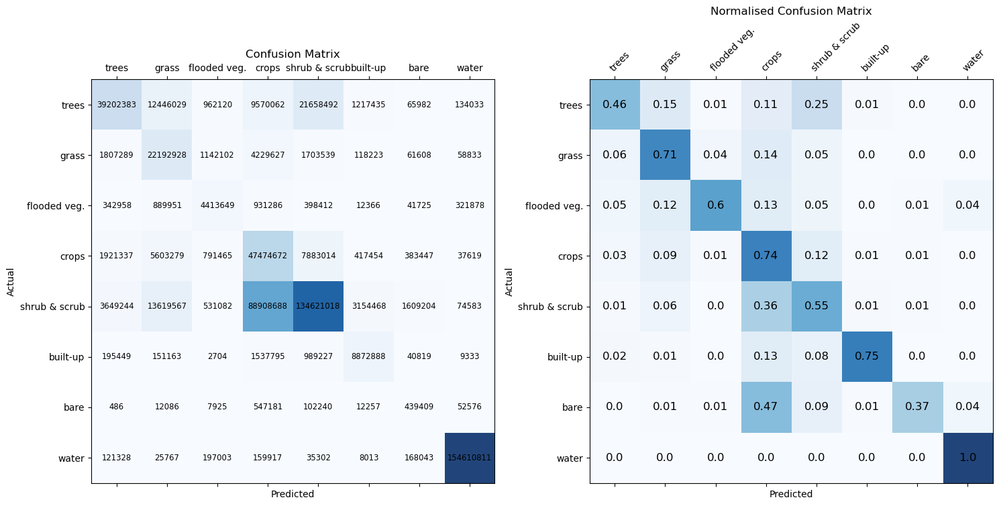

Confusion matrix for all classes


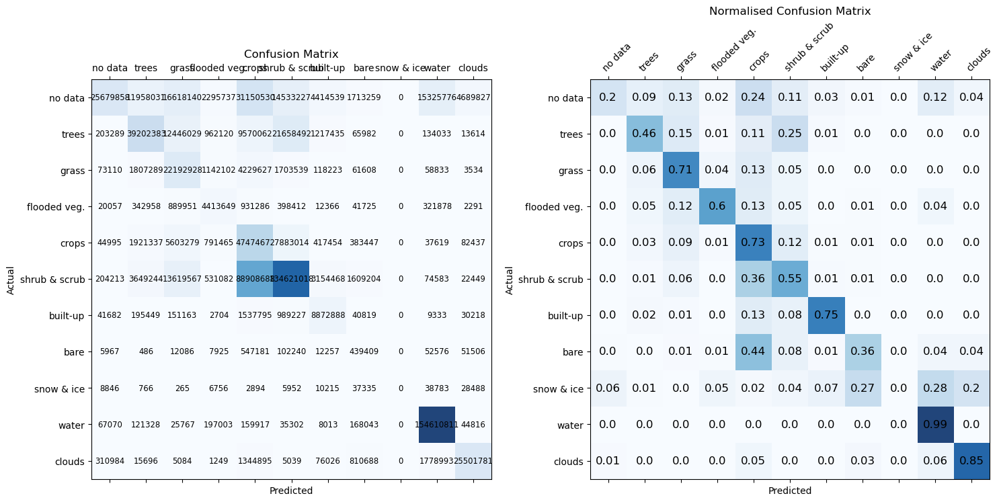

In [52]:
# Print best model metrics
print(f"Best validation accuracy: {val_results['best_val_accuracy']:.4f}")
print(f"Best averaged validation precision: {val_results['best_val_precision']:.4f}")
print(f"Best averaged validation recall: {val_results['best_val_recall']:.4f}")
print(f"Best averaged validation f1 score: {val_results['best_val_f1_score']:.4f}")

print(f"Best validation f1 score - class 01: {best_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Best validation f1 score - class 02: {best_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Best validation f1 score - class 03: {best_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Best validation f1 score - class 04: {best_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Best validation f1 score - class 05: {best_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Best validation f1 score - class 06: {best_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Best validation f1 score - class 07: {best_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Best validation f1 score - class 09: {best_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix, labels_all)

Plots of image patches

cuda


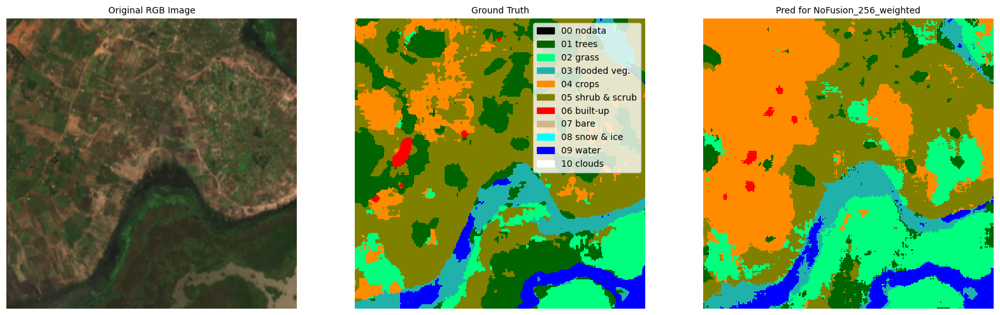

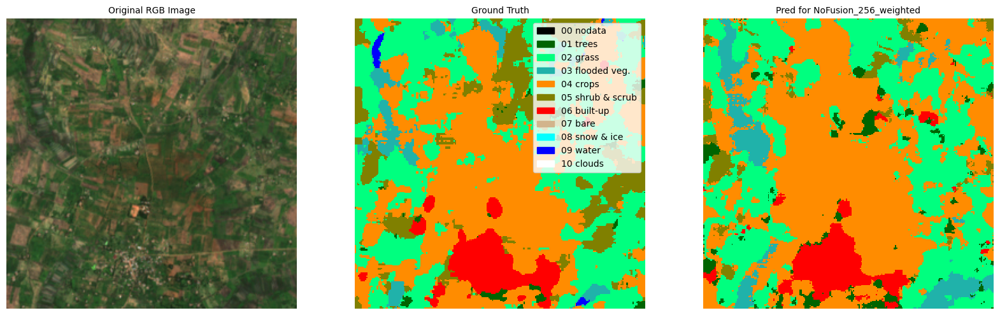

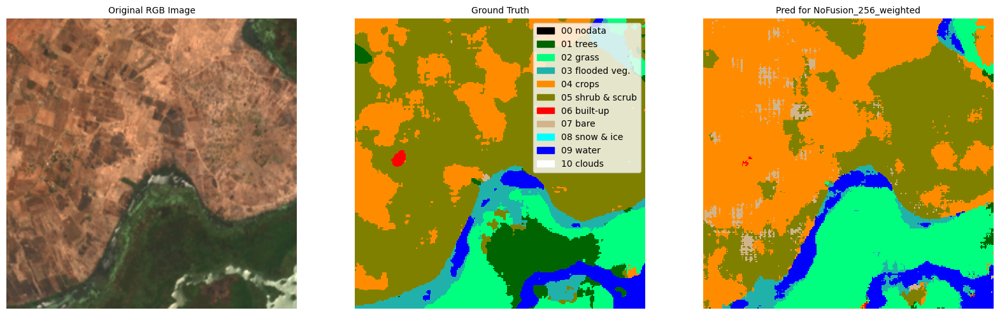

In [22]:
# Check if GPU is available
dataset_for_prediction = torch.utils.data.Subset(dataset_no_fusion_256, val_indices_256)

# Plot prediction and ground truth overlayed on rgb image
for i in [1588, 10796, 1604]:
    rgb = dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = dataset_for_prediction[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, dataset_for_prediction, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['NoFusion_256_weighted'])

### 4.2 Early fusion model

#### 3 Time steps

In [28]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 12 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 64
val_dataloader = DataLoader(preprocessed_val_dataset_256_early3, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.58
PATH = f"EarlyFusionCNN3_bestf1_{saved_f1}.pth"
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store validation results
val_results = {
    "best_val_accuracy": 0.0,
    "best_val_f1_score": 0.0,
    "best_val_recall": 0.0,
    "best_val_precision": 0.0,
}

best_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Validate model
_, running_val_confusion_matrix = validate_model(model, criterion, val_dataloader, device, NUM_CLASSES, class_labels)
running_val_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_val_confusion_matrix, exlude_classes)

# Update best f1 scores per class
val_precision, val_recall, val_f1_score = calculate_metrics(running_val_confusion_matrix_reduced)

for i, f1 in enumerate(val_f1_score):
    best_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
val_precision_avg = val_precision.mean()
val_recall_avg = val_recall.mean()
val_f1_score_avg = val_f1_score.mean()
val_accuracy = running_val_confusion_matrix_reduced.trace() / running_val_confusion_matrix.sum()

# Update results lists
val_results["best_val_accuracy"] = val_accuracy
val_results["best_val_precision"] = val_precision_avg
val_results["best_val_recall"] = val_recall_avg
val_results["best_val_f1_score"] = val_f1_score_avg

cuda


Best validation accuracy: 0.6053
Best averaged validation precision: 0.6114
Best averaged validation recall: 0.5922
Best averaged validation f1 score: 0.5762
Best validation f1 score - class 01: 0.5732 (trees)
Best validation f1 score - class 02: 0.5294 (grass)
Best validation f1 score - class 03: 0.5584 (flooded veg.)
Best validation f1 score - class 04: 0.3738 (crops)
Best validation f1 score - class 05: 0.8000 (shrub & scrub)
Best validation f1 score - class 06: 0.6054 (built-up)
Best validation f1 score - class 07: 0.1736 (bare)
Best validation f1 score - class 09: 0.9957 (water)
Confusion matrix for all relevant classes


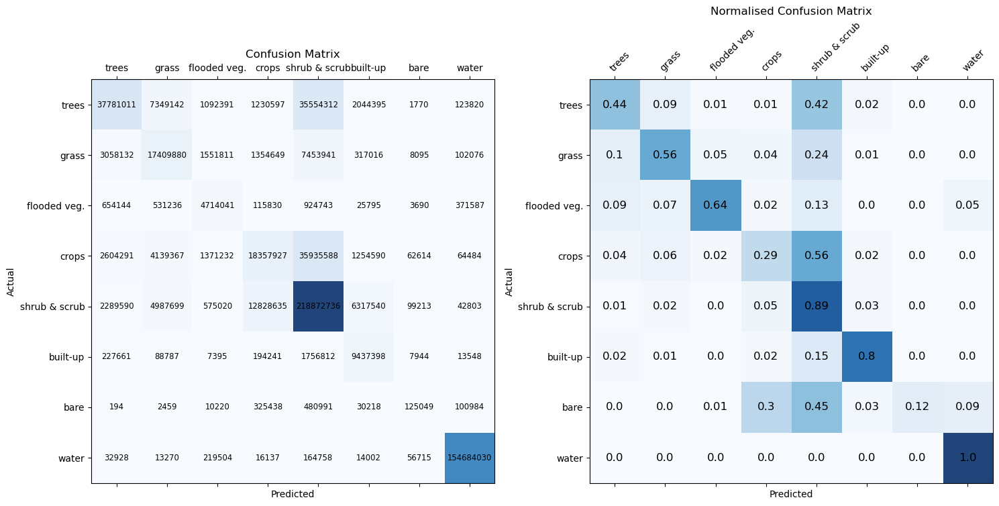

Confusion matrix for all classes


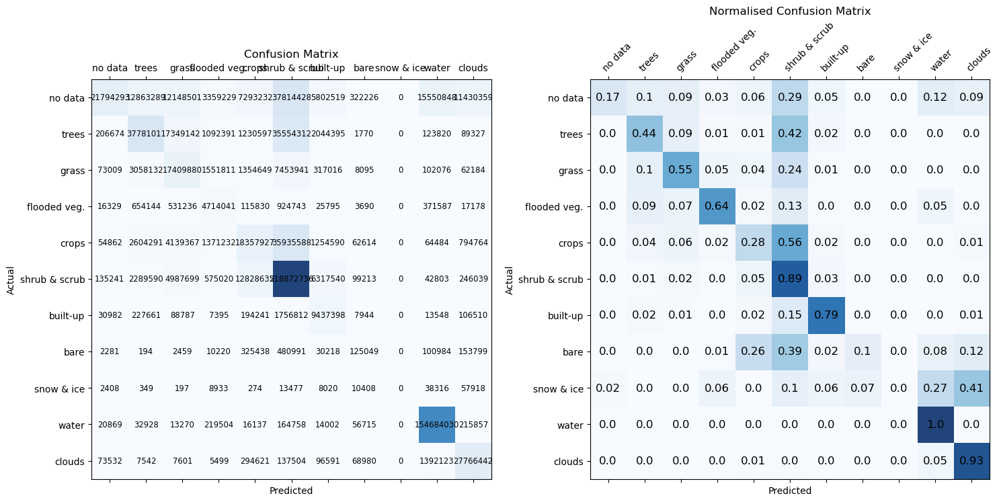

In [29]:
# Print best model metrics
print(f"Best validation accuracy: {val_results['best_val_accuracy']:.4f}")
print(f"Best averaged validation precision: {val_results['best_val_precision']:.4f}")
print(f"Best averaged validation recall: {val_results['best_val_recall']:.4f}")
print(f"Best averaged validation f1 score: {val_results['best_val_f1_score']:.4f}")

print(f"Best validation f1 score - class 01: {best_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Best validation f1 score - class 02: {best_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Best validation f1 score - class 03: {best_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Best validation f1 score - class 04: {best_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Best validation f1 score - class 05: {best_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Best validation f1 score - class 06: {best_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Best validation f1 score - class 07: {best_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Best validation f1 score - class 09: {best_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix, labels_all)

cuda


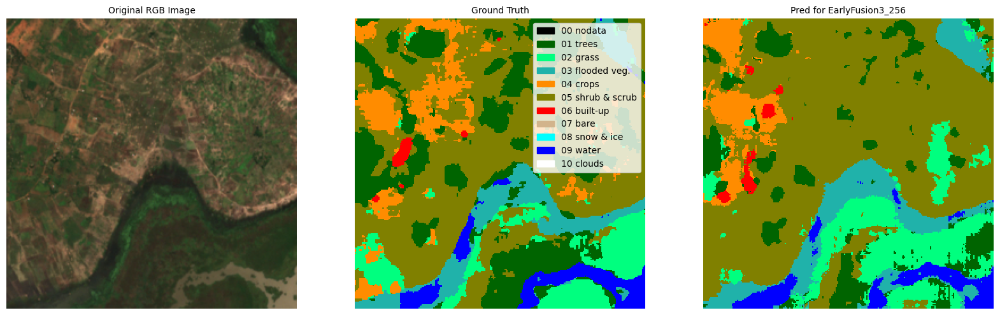

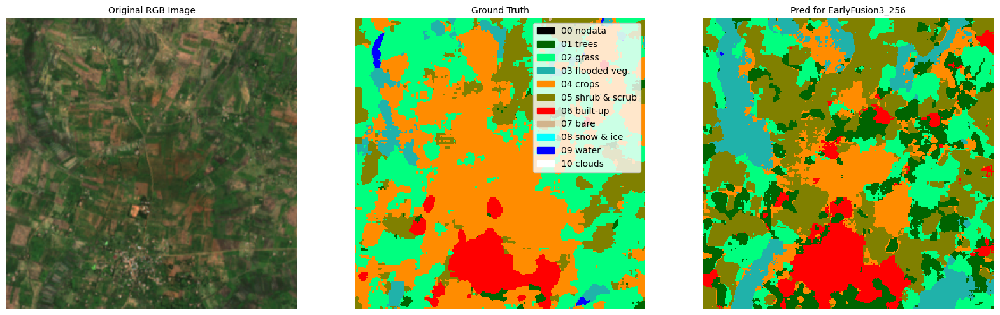

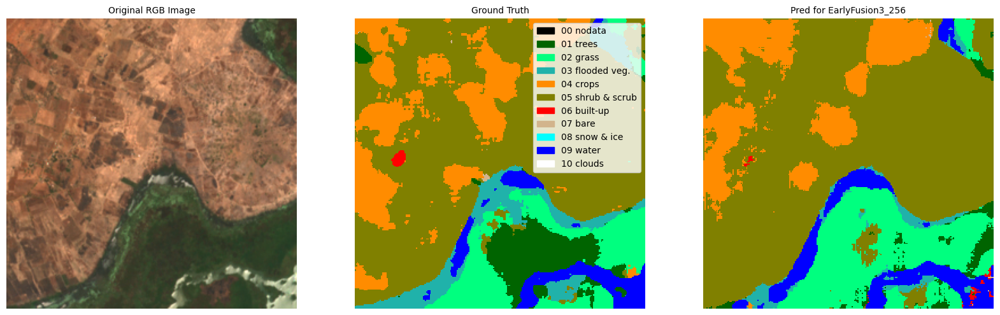

In [24]:
dataset_for_prediction = torch.utils.data.Subset(dataset_earlyfusion_256_3, val_indices_256)

# Plot prediction and ground truth overlayed on rgb image
for i in [1588, 10796, 1604]:
    rgb = dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = dataset_for_prediction[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, dataset_for_prediction, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['EarlyFusion3_256'])

#### 3 Time steps with Attention

In [39]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 12 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 64
val_dataloader = DataLoader(preprocessed_val_dataset_256_early3, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.5
PATH = f"saved_models/EarlyFusionCNN3_Attention_bestf1_{saved_f1}.pth"

# load model
model = load_model(Unet_DW_attention, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store validation results
val_results = {
    "best_val_accuracy": 0.0,
    "best_val_f1_score": 0.0,
    "best_val_recall": 0.0,
    "best_val_precision": 0.0,
}

best_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Validate model
_, running_val_confusion_matrix = validate_model(model, criterion, val_dataloader, device, NUM_CLASSES, class_labels)
running_val_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_val_confusion_matrix, exlude_classes)

# Update best f1 scores per class
val_precision, val_recall, val_f1_score = calculate_metrics(running_val_confusion_matrix_reduced)

for i, f1 in enumerate(val_f1_score):
    best_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
val_precision_avg = val_precision.mean()
val_recall_avg = val_recall.mean()
val_f1_score_avg = val_f1_score.mean()
val_accuracy = running_val_confusion_matrix_reduced.trace() / running_val_confusion_matrix.sum()

# Update results lists
val_results["best_val_accuracy"] = val_accuracy
val_results["best_val_precision"] = val_precision_avg
val_results["best_val_recall"] = val_recall_avg
val_results["best_val_f1_score"] = val_f1_score_avg

cuda


Best validation accuracy: 0.5763
Best averaged validation precision: 0.5790
Best averaged validation recall: 0.5312
Best averaged validation f1 score: 0.4999
Best validation f1 score - class 01: 0.4808 (trees)
Best validation f1 score - class 02: 0.4785 (grass)
Best validation f1 score - class 03: 0.4629 (flooded veg.)
Best validation f1 score - class 04: 0.2822 (crops)
Best validation f1 score - class 05: 0.7736 (shrub & scrub)
Best validation f1 score - class 06: 0.4634 (built-up)
Best validation f1 score - class 07: 0.0642 (bare)
Best validation f1 score - class 09: 0.9933 (water)
Confusion matrix for all relevant classes


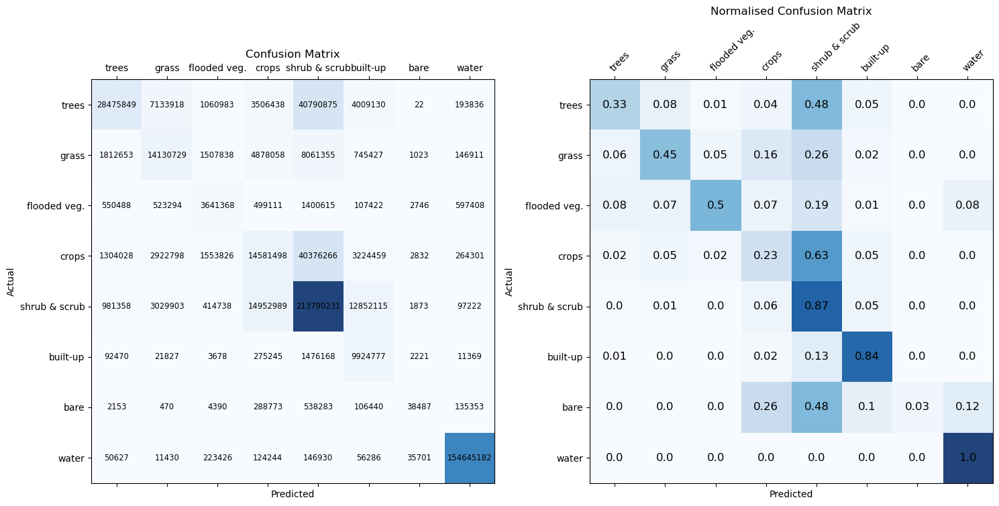

Confusion matrix for all classes


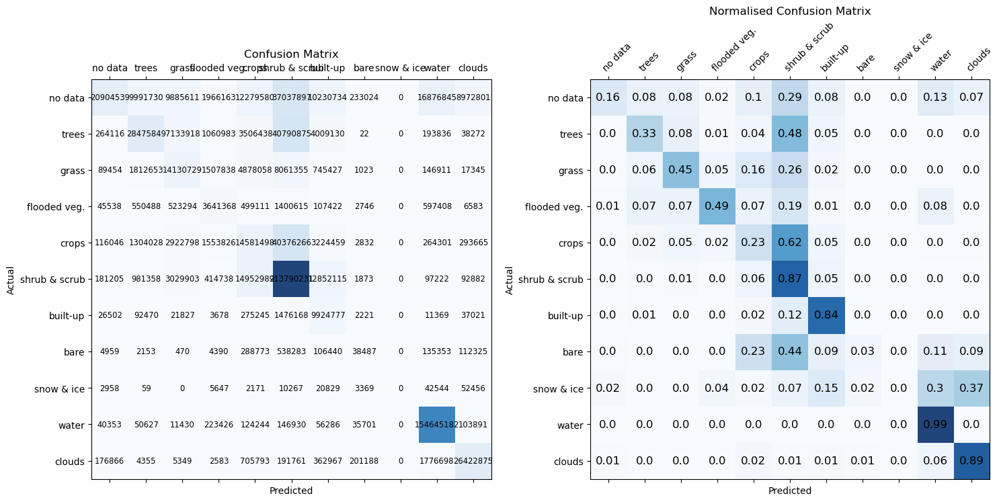

In [40]:
# Print best model metrics
print(f"Best validation accuracy: {val_results['best_val_accuracy']:.4f}")
print(f"Best averaged validation precision: {val_results['best_val_precision']:.4f}")
print(f"Best averaged validation recall: {val_results['best_val_recall']:.4f}")
print(f"Best averaged validation f1 score: {val_results['best_val_f1_score']:.4f}")

print(f"Best validation f1 score - class 01: {best_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Best validation f1 score - class 02: {best_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Best validation f1 score - class 03: {best_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Best validation f1 score - class 04: {best_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Best validation f1 score - class 05: {best_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Best validation f1 score - class 06: {best_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Best validation f1 score - class 07: {best_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Best validation f1 score - class 09: {best_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix, labels_all)

cuda


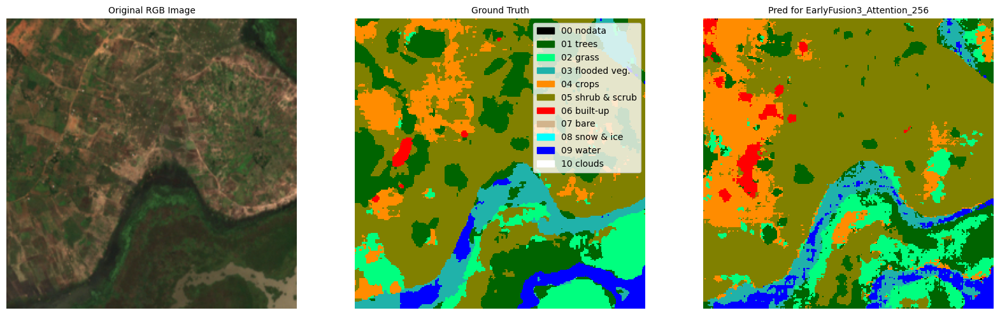

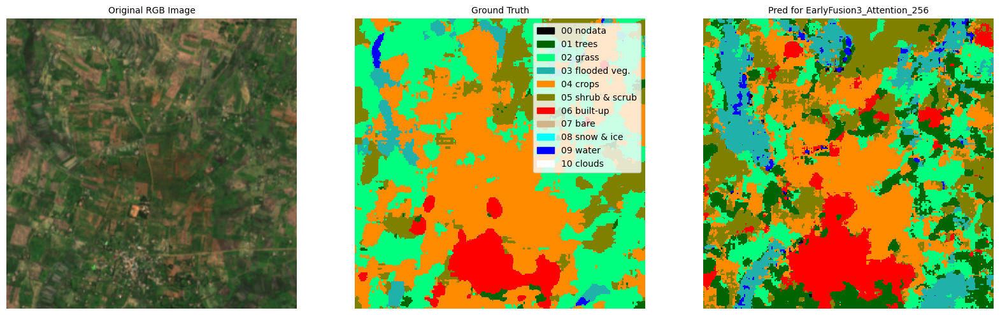

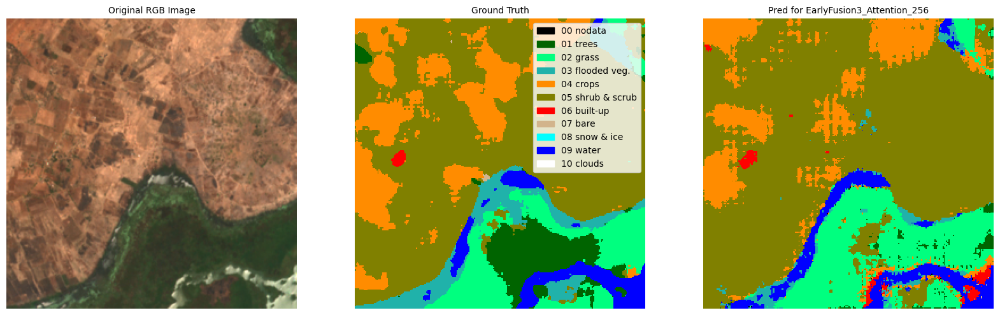

In [26]:
dataset_for_prediction = torch.utils.data.Subset(dataset_earlyfusion_256_3, val_indices_256)

# Plot prediction and ground truth overlayed on rgb image
for i in [1588, 10796, 1604]:
    rgb = dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = dataset_for_prediction[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, dataset_for_prediction, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['EarlyFusion3_Attention_256'])

#### 5 Time steps

In [36]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 20 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 64
val_dataloader = DataLoader(preprocessed_val_dataset_256_early5, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.53
PATH = f"saved_models/EarlyFusionCNN5_bestf1_{saved_f1}.pth"

# load model
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store validation results
val_results = {
    "best_val_accuracy": 0.0,
    "best_val_f1_score": 0.0,
    "best_val_recall": 0.0,
    "best_val_precision": 0.0,
}

best_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Validate model
_, running_val_confusion_matrix = validate_model(model, criterion, val_dataloader, device, NUM_CLASSES, class_labels)
running_val_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_val_confusion_matrix, exlude_classes)

# Update best f1 scores per class
val_precision, val_recall, val_f1_score = calculate_metrics(running_val_confusion_matrix_reduced)

for i, f1 in enumerate(val_f1_score):
    best_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
val_precision_avg = val_precision.mean()
val_recall_avg = val_recall.mean()
val_f1_score_avg = val_f1_score.mean()
val_accuracy = running_val_confusion_matrix_reduced.trace() / running_val_confusion_matrix.sum()

# Update results lists
val_results["best_val_accuracy"] = val_accuracy
val_results["best_val_precision"] = val_precision_avg
val_results["best_val_recall"] = val_recall_avg
val_results["best_val_f1_score"] = val_f1_score_avg

cuda


Best validation accuracy: 0.5804
Best averaged validation precision: 0.5810
Best averaged validation recall: 0.5773
Best averaged validation f1 score: 0.5253
Best validation f1 score - class 01: 0.5455 (trees)
Best validation f1 score - class 02: 0.5223 (grass)
Best validation f1 score - class 03: 0.4978 (flooded veg.)
Best validation f1 score - class 04: 0.3099 (crops)
Best validation f1 score - class 05: 0.7743 (shrub & scrub)
Best validation f1 score - class 06: 0.4149 (built-up)
Best validation f1 score - class 07: 0.1436 (bare)
Best validation f1 score - class 09: 0.9943 (water)
Confusion matrix for all relevant classes


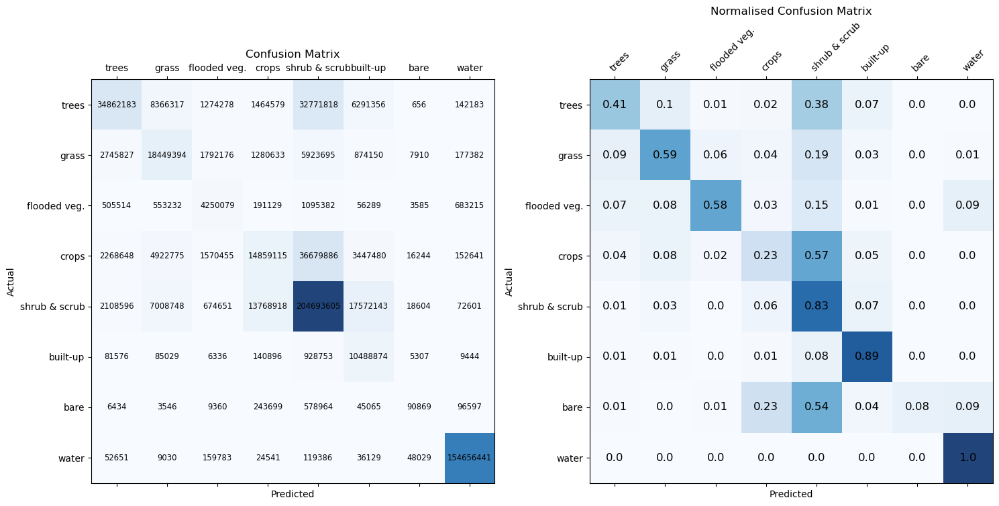

Confusion matrix for all classes


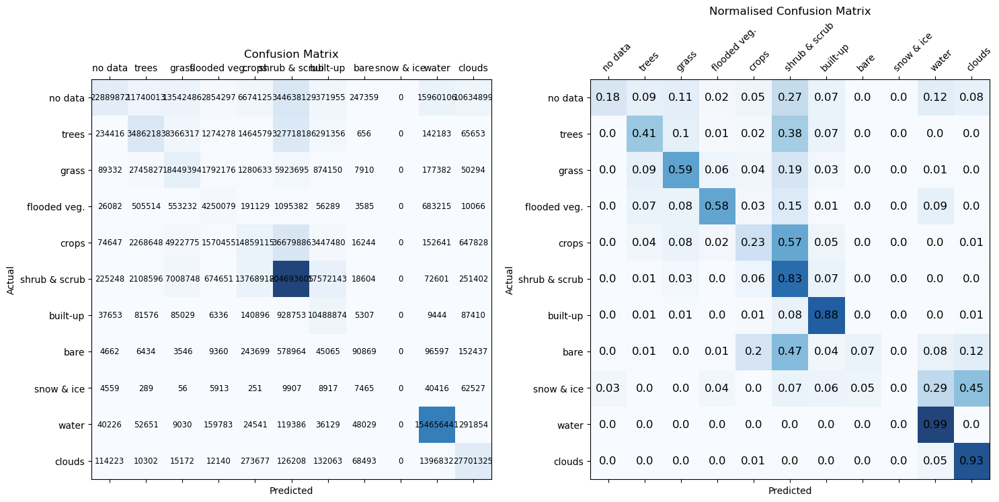

In [39]:
# Print best model metrics
print(f"Best validation accuracy: {val_results['best_val_accuracy']:.4f}")
print(f"Best averaged validation precision: {val_results['best_val_precision']:.4f}")
print(f"Best averaged validation recall: {val_results['best_val_recall']:.4f}")
print(f"Best averaged validation f1 score: {val_results['best_val_f1_score']:.4f}")

print(f"Best validation f1 score - class 01: {best_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Best validation f1 score - class 02: {best_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Best validation f1 score - class 03: {best_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Best validation f1 score - class 04: {best_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Best validation f1 score - class 05: {best_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Best validation f1 score - class 06: {best_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Best validation f1 score - class 07: {best_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Best validation f1 score - class 09: {best_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix, labels_all)

cuda


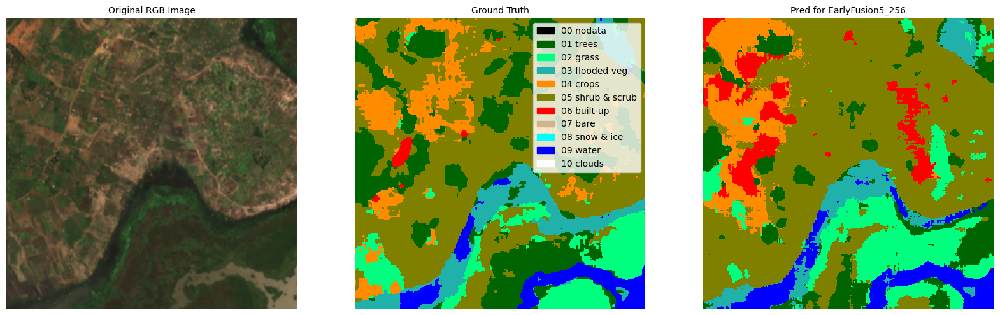

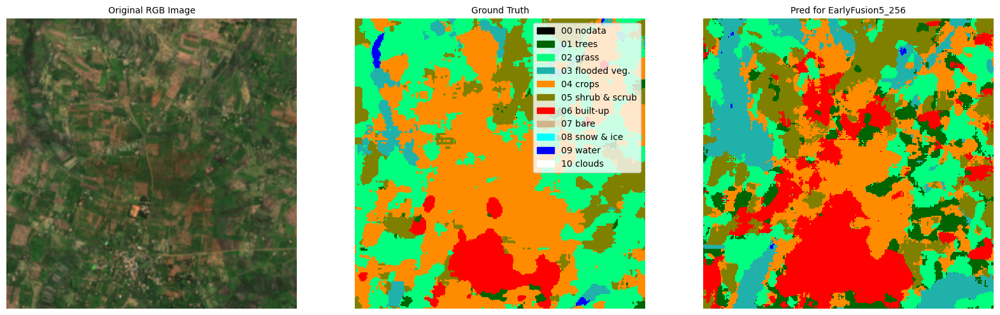

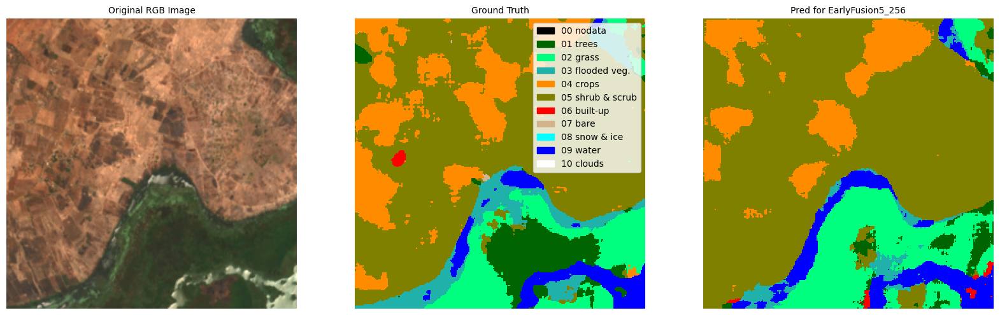

In [27]:
dataset_for_prediction = torch.utils.data.Subset(dataset_earlyfusion_256_5, val_indices_256)

# Plot prediction and ground truth overlayed on rgb image
for i in [1588, 10796, 1604]:
    rgb = dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = dataset_for_prediction[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, dataset_for_prediction, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['EarlyFusion5_256'])

### 4.3 Score fusion model

#### 3 Time steps

In [32]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 4 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 8
val_dataloader = DataLoader(preprocessed_val_dataset_256_score3, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load cnn model
saved_f1 = 0.58
PATH1 = f"NoFusionCNN_bestf1_{saved_f1}.pth"
cnn_model = load_model(Unet_DW, PATH1, device, NUM_CHANNELS, NUM_CLASSES)

# load score fusion model
saved_f1 = 0.3
PATH2 = f"ScoreFusionCNN3_bestf1_{saved_f1}.pth"

# load model
fusion_model = loadfusionmodel(FullyConnectedFusion, PATH2, device, NUM_CLASSES)

# store validation results
val_results = {
    "best_val_accuracy": 0.0,
    "best_val_f1_score": 0.0,
    "best_val_recall": 0.0,
    "best_val_precision": 0.0,
}

best_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Validate model
_, running_val_confusion_matrix = validate_score_fusion(fusion_model, cnn_model, val_dataloader, criterion, device, 3, NUM_CLASSES, class_labels)
running_val_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_val_confusion_matrix, exlude_classes)

# Update best f1 scores per class
val_precision, val_recall, val_f1_score = calculate_metrics(running_val_confusion_matrix_reduced)

for i, f1 in enumerate(val_f1_score):
    best_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
val_precision_avg = val_precision.mean()
val_recall_avg = val_recall.mean()
val_f1_score_avg = val_f1_score.mean()
val_accuracy = running_val_confusion_matrix_reduced.trace() / running_val_confusion_matrix.sum()

# Update results lists
val_results["best_val_accuracy"] = val_accuracy
val_results["best_val_precision"] = val_precision_avg
val_results["best_val_recall"] = val_recall_avg
val_results["best_val_f1_score"] = val_f1_score_avg

cuda


Best validation accuracy: 0.5344
Best averaged validation precision: 0.3619
Best averaged validation recall: 0.3083
Best averaged validation f1 score: 0.3024
Best validation f1 score - class 01: 0.3207 (trees)
Best validation f1 score - class 02: 0.0778 (grass)
Best validation f1 score - class 03: 0.0116 (flooded veg.)
Best validation f1 score - class 04: 0.0144 (crops)
Best validation f1 score - class 05: 0.7458 (shrub & scrub)
Best validation f1 score - class 06: 0.2831 (built-up)
Best validation f1 score - class 07: 0.0001 (bare)
Best validation f1 score - class 09: 0.9658 (water)
Confusion matrix for all relevant classes


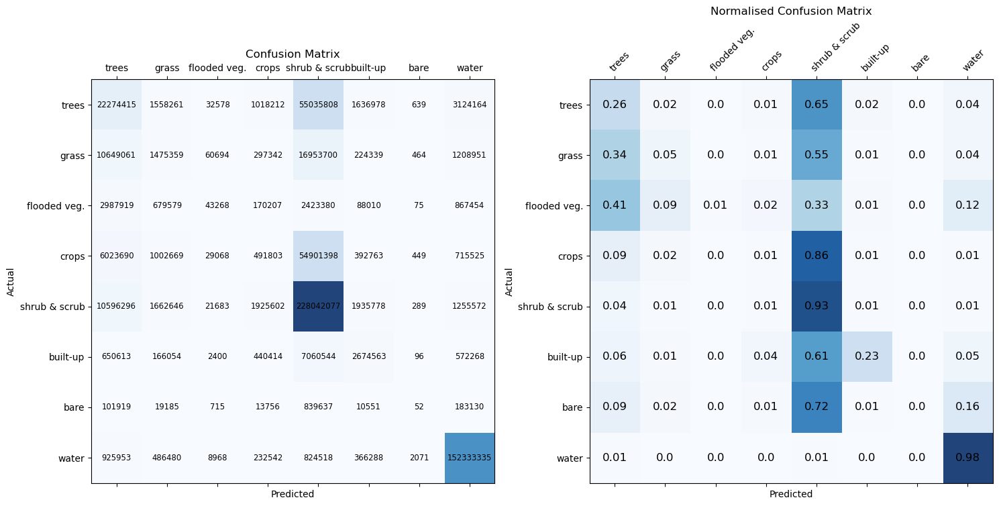

Confusion matrix for all classes


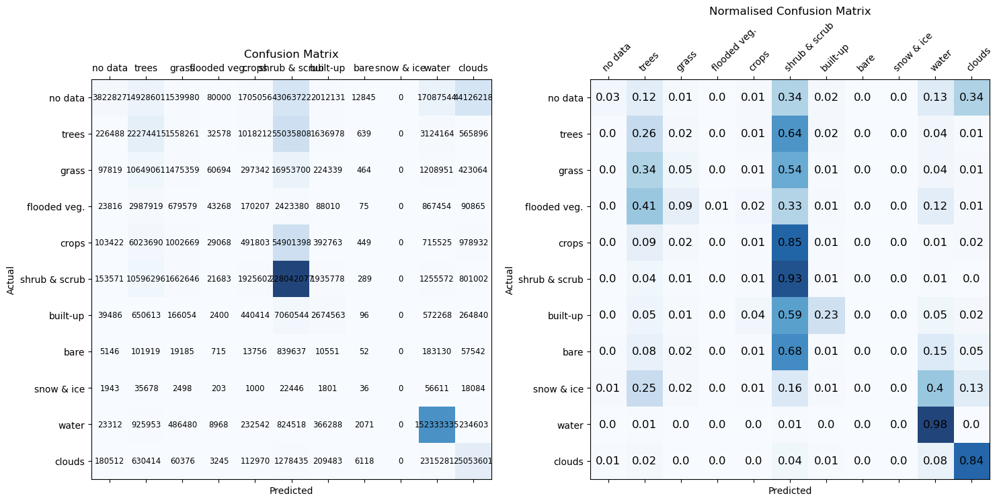

In [33]:
# Print best model metrics
print(f"Best validation accuracy: {val_results['best_val_accuracy']:.4f}")
print(f"Best averaged validation precision: {val_results['best_val_precision']:.4f}")
print(f"Best averaged validation recall: {val_results['best_val_recall']:.4f}")
print(f"Best averaged validation f1 score: {val_results['best_val_f1_score']:.4f}")

print(f"Best validation f1 score - class 01: {best_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Best validation f1 score - class 02: {best_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Best validation f1 score - class 03: {best_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Best validation f1 score - class 04: {best_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Best validation f1 score - class 05: {best_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Best validation f1 score - class 06: {best_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Best validation f1 score - class 07: {best_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Best validation f1 score - class 09: {best_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix, labels_all)

In [ ]:
dataset_for_prediction = torch.utils.data.Subset(dataset_fusion_score3, val_indices_256)

# Plot prediction and ground truth overlayed on rgb image
for i in [1588, 10796, 1604]:
    rgb = dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = dataset_for_prediction[i][3].squeeze(0).cpu().numpy()
    pred = predict_on_patch_score(fusion_model, cnn_model, dataset_for_prediction, i, device, 3)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['ScoreFusion3'])

#### 5 Time steps

In [50]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 4 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 8
val_dataloader = DataLoader(preprocessed_val_dataset_256_score5, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load cnn model
saved_f1 = 0.58
PATH1 = f"NoFusionCNN_bestf1_{saved_f1}.pth"
cnn_model = load_model(Unet_DW, PATH1, device, NUM_CHANNELS, NUM_CLASSES)

# load score fusion model
saved_f1 = 0.0
PATH2 = f"ScoreFusionCNN5_bestf1_{saved_f1}.pth"

# load model
fusion_model = loadfusionmodel(FullyConnectedFusion, PATH2, device, NUM_CLASSES)

# store validation results
val_results = {
    "best_val_accuracy": 0.0,
    "best_val_f1_score": 0.0,
    "best_val_recall": 0.0,
    "best_val_precision": 0.0,
}

best_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Validate model
_, running_val_confusion_matrix = validate_score_fusion(fusion_model, cnn_model, val_dataloader, criterion, device, 5, NUM_CLASSES, class_labels)
running_val_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_val_confusion_matrix, exlude_classes)

# Update best f1 scores per class
val_precision, val_recall, val_f1_score = calculate_metrics(running_val_confusion_matrix_reduced)

for i, f1 in enumerate(val_f1_score):
    best_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
val_precision_avg = val_precision.mean()
val_recall_avg = val_recall.mean()
val_f1_score_avg = val_f1_score.mean()
val_accuracy = running_val_confusion_matrix_reduced.trace() / running_val_confusion_matrix.sum()

# Update results lists
val_results["best_val_accuracy"] = val_accuracy
val_results["best_val_precision"] = val_precision_avg
val_results["best_val_recall"] = val_recall_avg
val_results["best_val_f1_score"] = val_f1_score_avg

cuda


Best validation accuracy: 0.4698
Best averaged validation precision: 0.2823
Best averaged validation recall: 0.2750
Best averaged validation f1 score: 0.2620
Best validation f1 score - class 01: 0.1428 (trees)
Best validation f1 score - class 02: 0.0385 (grass)
Best validation f1 score - class 03: 0.0001 (flooded veg.)
Best validation f1 score - class 04: 0.1582 (crops)
Best validation f1 score - class 05: 0.6780 (shrub & scrub)
Best validation f1 score - class 06: 0.1510 (built-up)
Best validation f1 score - class 07: 0.0000 (bare)
Best validation f1 score - class 09: 0.9278 (water)
Confusion matrix for all relevant classes


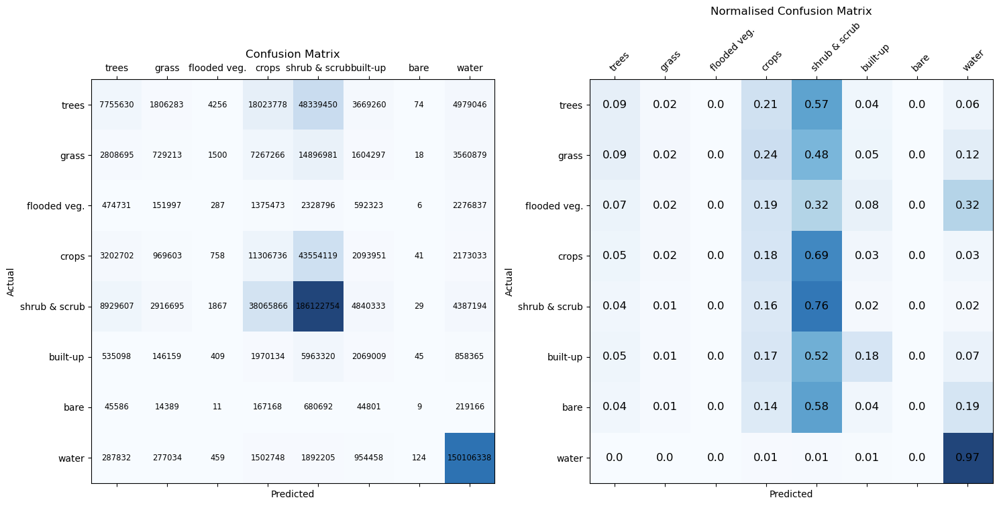

Confusion matrix for all classes


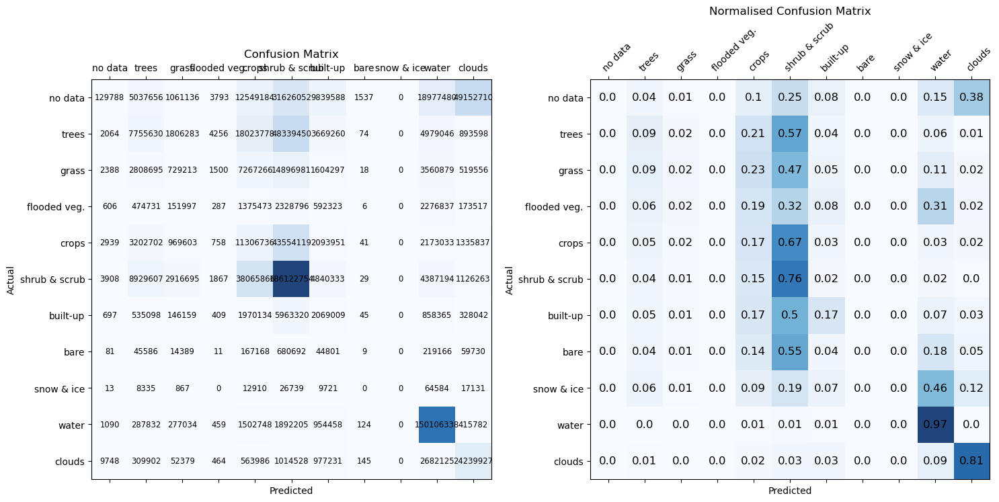

In [51]:
# Print best model metrics
print(f"Best validation accuracy: {val_results['best_val_accuracy']:.4f}")
print(f"Best averaged validation precision: {val_results['best_val_precision']:.4f}")
print(f"Best averaged validation recall: {val_results['best_val_recall']:.4f}")
print(f"Best averaged validation f1 score: {val_results['best_val_f1_score']:.4f}")

print(f"Best validation f1 score - class 01: {best_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Best validation f1 score - class 02: {best_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Best validation f1 score - class 03: {best_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Best validation f1 score - class 04: {best_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Best validation f1 score - class 05: {best_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Best validation f1 score - class 06: {best_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Best validation f1 score - class 07: {best_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Best validation f1 score - class 09: {best_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_val_confusion_matrix, labels_all)

In [ ]:
dataset_for_prediction = torch.utils.data.Subset(dataset_fusion_score5, val_indices_256)

# Plot prediction and ground truth overlayed on rgb image
for i in [1588, 10796, 1604]:
    rgb = dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = dataset_for_prediction[i][5].squeeze(0).cpu().numpy()
    pred = predict_on_patch_score(fusion_model, cnn_model, dataset_for_prediction, i, device, 5)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['ScoreFusion5'])

## 5. Testing

### 5.1 Creating the test set

In [33]:
directory = "/home"
base_path = f"{directory}/pf/pfstud/mlarriere/aligned_data/"
dw_path = f"{directory}/pf/pfstud/mlarriere/DW_files/DW_timeslices/"

tile_length = 16
tiles_season = {'winter': [0, 1, 15], 'spring': [2, 3, 4, 5], 'summer': [6, 7, 8, 9, 10, 11, 12, 13, 14]}

# create files for all h5 image tiles
h5_files_DAR = [f"{base_path}DAR_aligned_{timestep}.h5" for timestep in range(0, tile_length)]
h5_files_DAR_winter = [f"{base_path}DAR_aligned_{timestep}.h5" for timestep in tiles_season['winter']]
h5_files_DAR_spring = [f"{base_path}DAR_aligned_{timestep}.h5" for timestep in tiles_season['spring']]
h5_files_DAR_summer = [f"{base_path}DAR_aligned_{timestep}.h5" for timestep in tiles_season['summer']]

# create files for all h5 land cover tiles
dw_files_DAR = [f"{dw_path}scaled_cloudy_DAR_dw_{timestep}.h5" for timestep in range(0, tile_length)]
dw_files_DAR_winter = [f"{dw_path}scaled_cloudy_DAR_dw_{timestep}.h5" for timestep in tiles_season['winter']]
dw_files_DAR_spring = [f"{dw_path}scaled_cloudy_DAR_dw_{timestep}.h5" for timestep in tiles_season['spring']]
dw_files_DAR_summer = [f"{dw_path}scaled_cloudy_DAR_dw_{timestep}.h5" for timestep in tiles_season['summer']]

In [36]:
file_names = {'CLD': 'CLD', 'RGB': 'RGB', 'NIR': 'NIR'}
dw_file_name = 'DW_cloudy'
cld_threshold = 1.0

test_dataset_no_fusion_256 = H5Dataset(h5_files_DAR, dw_files_DAR, file_name = file_names, dw_file_name=dw_file_name, patch_size=(256, 256), cloud_threshold = 1.0, augment=False, num_augment=1)
test_dataset_earlyfusion_256_3 = H5Dataset_early(h5_files_DAR, dw_files_DAR, file_name = file_names, dw_file_name=dw_file_name, patch_size=(256, 256), cloud_threshold = 1.0, 
                         calculate_time_slice_indices=False, time_file_name='precomputed_indices/time_slice_indices_precomputed_256_early3.pkl', timesteps=3)
test_dataset_separated = H5Dataset(h5_files_DAR, dw_files_DAR, file_name=file_names, dw_file_name=dw_file_name ,patch_size=(256, 256), cloud_threshold = cld_threshold, return_rgb_nir_separately=True, augment=False, num_augment=1)

### 5.2 Testing on full test set

#### 5.2.1 Baseline

In [29]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 4 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 16
test_dataloader = DataLoader(test_dataset_no_fusion_256, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.31
PATH = f"saved_models/BaselineCNN_bestf1_{saved_f1}.pth"
model = load_model(Unet_DW_baseline, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store test results
test_results = {
    "test_accuracy": 0.0,
    "test_f1_score": 0.0,
    "test_recall": 0.0,
    "test_precision": 0.0,
}

test_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Test model
_, running_test_confusion_matrix = validate_model(model, criterion, test_dataloader, device, NUM_CLASSES, class_labels)
running_test_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_test_confusion_matrix, exlude_classes)

# Update best f1 scores per class
test_precision, test_recall, test_f1_score = calculate_metrics(running_test_confusion_matrix_reduced)

for i, f1 in enumerate(test_f1_score):
    test_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
test_precision_avg = test_precision.mean()
test_recall_avg = test_recall.mean()
test_f1_score_avg = test_f1_score.mean()
test_accuracy = running_test_confusion_matrix_reduced.trace() / running_test_confusion_matrix.sum()

# Update results lists
test_results["test_accuracy"] = test_accuracy
test_results["test_precision"] = test_precision_avg
test_results["test_recall"] = test_recall_avg
test_results["test_f1_score"] = test_f1_score_avg

cuda


Test accuracy: 0.4325
Test precision: 0.2470
Test recall: 0.3101
Test f1 score: 0.2529
Test f1 score - class 01: 0.6771 (trees)
Test f1 score - class 02: 0.0000 (grass)
Test f1 score - class 03: 0.0060 (flooded veg.)
Test f1 score - class 04: 0.0036 (crops)
Test f1 score - class 05: 0.3876 (shrub & scrub)
Test f1 score - class 06: 0.0000 (built-up)
Test f1 score - class 07: 0.0000 (bare)
Test f1 score - class 09: 0.9491 (water)
Confusion matrix for all relevant classes


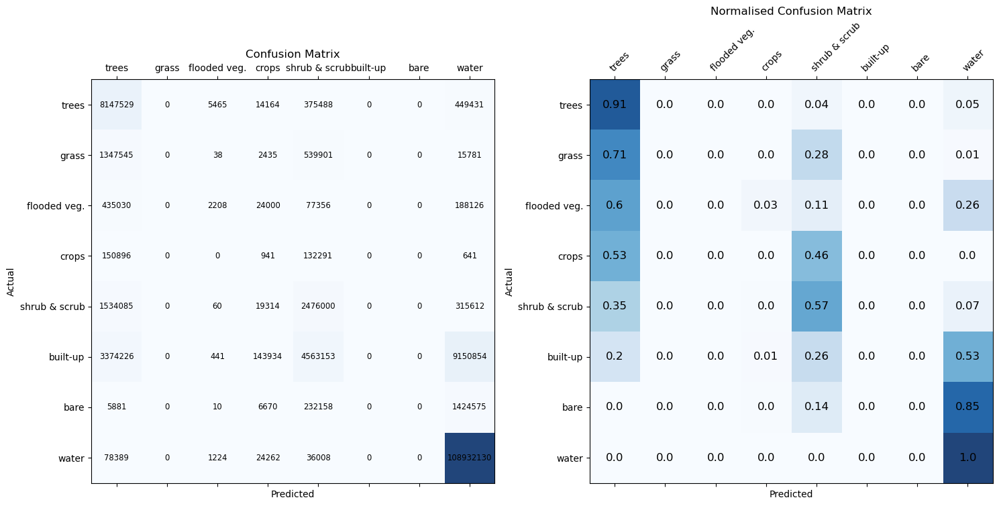

Confusion matrix for all classes


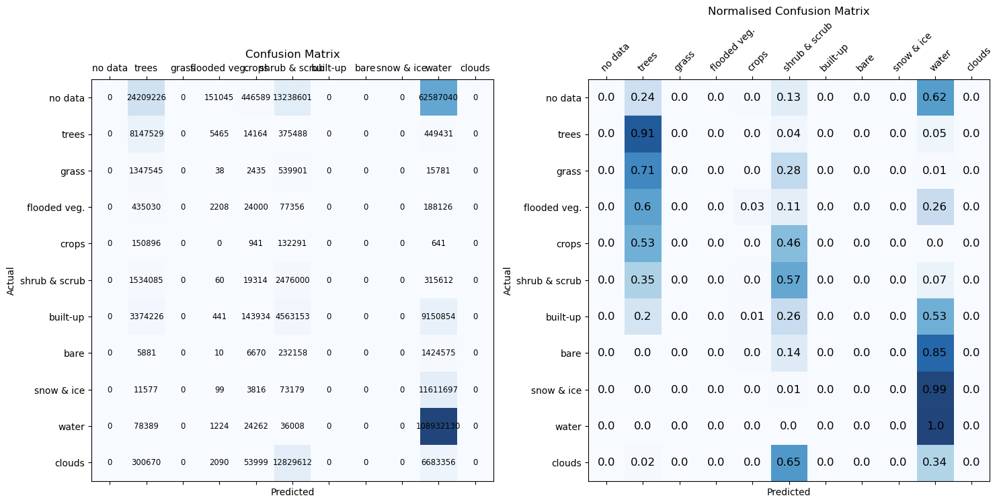

In [30]:
# Print best model metrics
print(f"Test accuracy: {test_results['test_accuracy']:.4f}")
print(f"Test precision: {test_results['test_precision']:.4f}")
print(f"Test recall: {test_results['test_recall']:.4f}")
print(f"Test f1 score: {test_results['test_f1_score']:.4f}")

print(f"Test f1 score - class 01: {test_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Test f1 score - class 02: {test_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Test f1 score - class 03: {test_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Test f1 score - class 04: {test_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Test f1 score - class 05: {test_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Test f1 score - class 06: {test_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Test f1 score - class 07: {test_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Test f1 score - class 09: {test_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_test_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_test_confusion_matrix, labels_all)

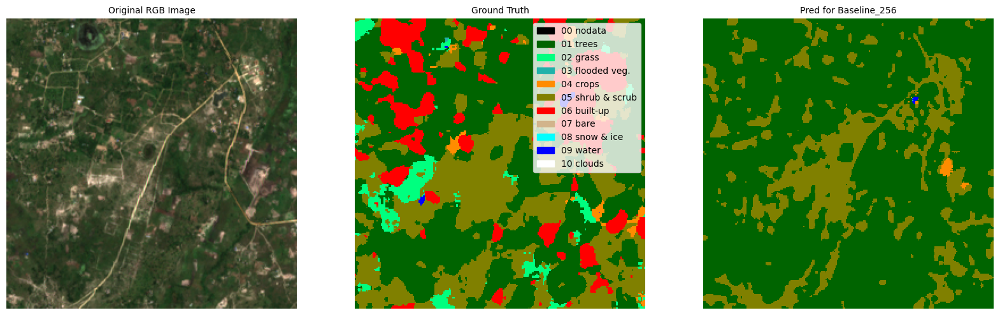

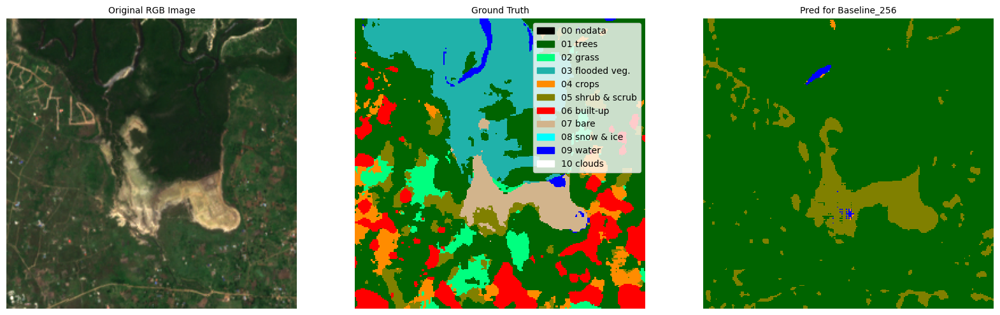

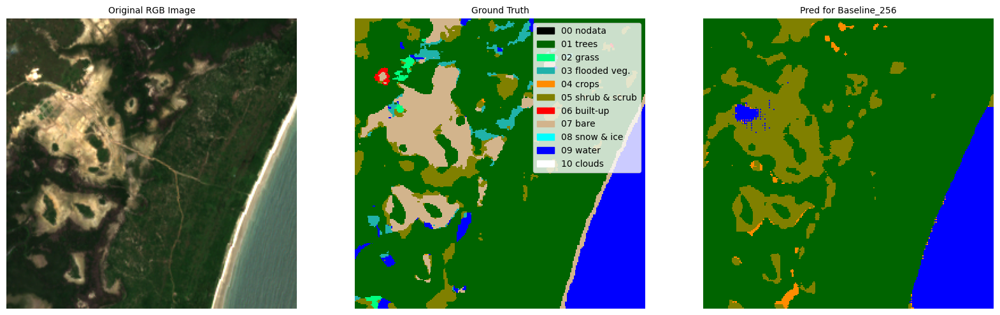

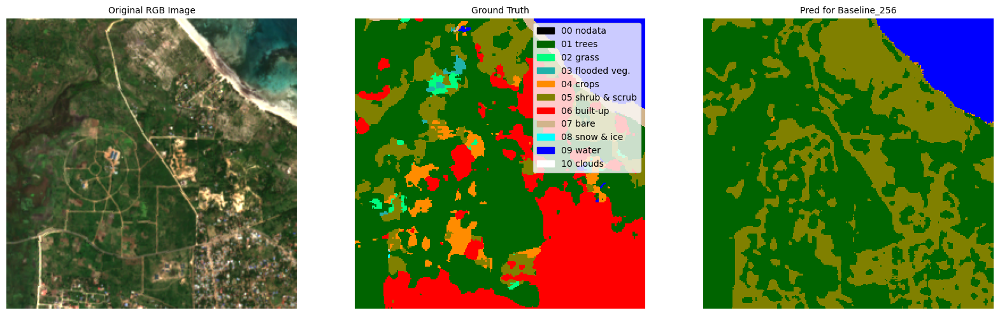

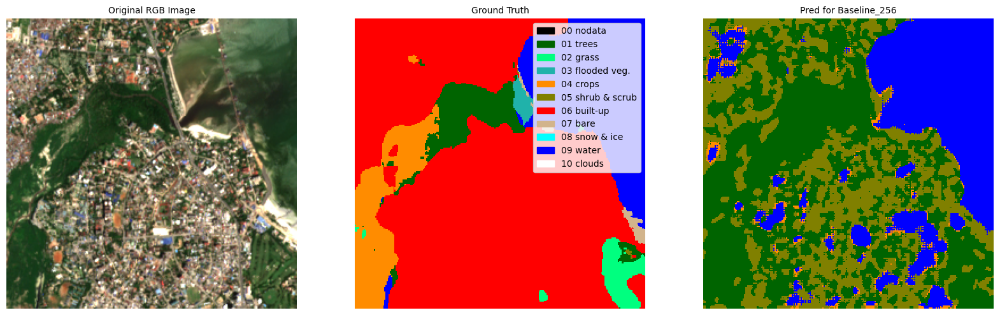

In [37]:
# Plot prediction and ground truth overlayed on rgb image
saved_f1 = 0.31
PATH = f"saved_models/BaselineCNN_bestf1_{saved_f1}.pth"
model = load_model(Unet_DW_baseline, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

for i in [3853, 6439, 4157, 2180, 21745]:
    rgb = test_dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = test_dataset_no_fusion_256[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, test_dataset_no_fusion_256, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['Baseline_256'])

#### 5.2.2 No fusion model

In [38]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 4 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 16
test_dataloader = DataLoader(test_dataset_no_fusion_256, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.58
PATH = f"saved_models/NoFusionCNN_bestf1_{saved_f1}.pth"
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store test results
test_results = {
    "test_accuracy": 0.0,
    "test_f1_score": 0.0,
    "test_recall": 0.0,
    "test_precision": 0.0,
}

test_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Test model
_, running_test_confusion_matrix = validate_model(model, criterion, test_dataloader, device, NUM_CLASSES, class_labels)
running_test_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_test_confusion_matrix, exlude_classes)

# Update best f1 scores per class
test_precision, test_recall, test_f1_score = calculate_metrics(running_test_confusion_matrix_reduced)

for i, f1 in enumerate(test_f1_score):
    test_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
test_precision_avg = test_precision.mean()
test_recall_avg = test_recall.mean()
test_f1_score_avg = test_f1_score.mean()
test_accuracy = running_test_confusion_matrix_reduced.trace() / running_test_confusion_matrix.sum()

# Update results lists
test_results["test_accuracy"] = test_accuracy
test_results["test_precision"] = test_precision_avg
test_results["test_recall"] = test_recall_avg
test_results["test_f1_score"] = test_f1_score_avg

cuda


Test accuracy: 0.3184
Test precision: 0.6107
Test recall: 0.5765
Test f1 score: 0.5793
Test f1 score - class 01: 0.7944 (trees)
Test f1 score - class 02: 0.4163 (grass)
Test f1 score - class 03: 0.4261 (flooded veg.)
Test f1 score - class 04: 0.0644 (crops)
Test f1 score - class 05: 0.6661 (shrub & scrub)
Test f1 score - class 06: 0.7819 (built-up)
Test f1 score - class 07: 0.4981 (bare)
Test f1 score - class 09: 0.9872 (water)
Confusion matrix for all relevant classes


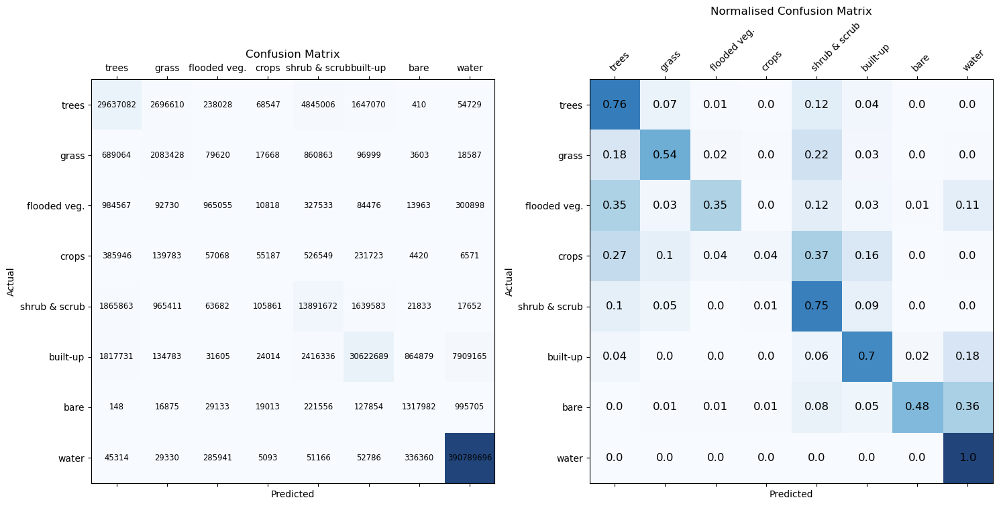

Confusion matrix for all classes


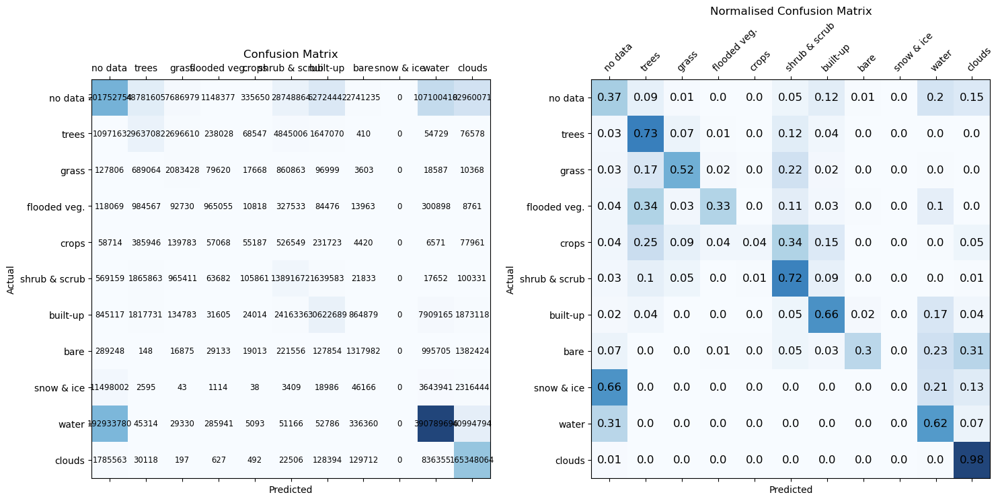

In [39]:
# Print best model metrics
print(f"Test accuracy: {test_results['test_accuracy']:.4f}")
print(f"Test precision: {test_results['test_precision']:.4f}")
print(f"Test recall: {test_results['test_recall']:.4f}")
print(f"Test f1 score: {test_results['test_f1_score']:.4f}")

print(f"Test f1 score - class 01: {test_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Test f1 score - class 02: {test_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Test f1 score - class 03: {test_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Test f1 score - class 04: {test_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Test f1 score - class 05: {test_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Test f1 score - class 06: {test_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Test f1 score - class 07: {test_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Test f1 score - class 09: {test_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_test_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_test_confusion_matrix, labels_all)

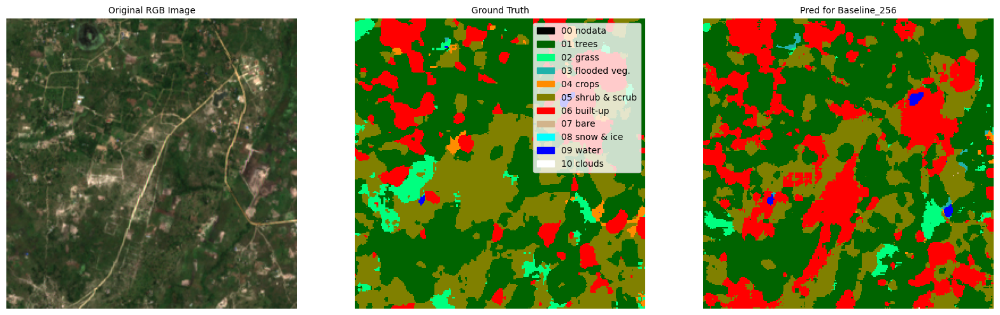

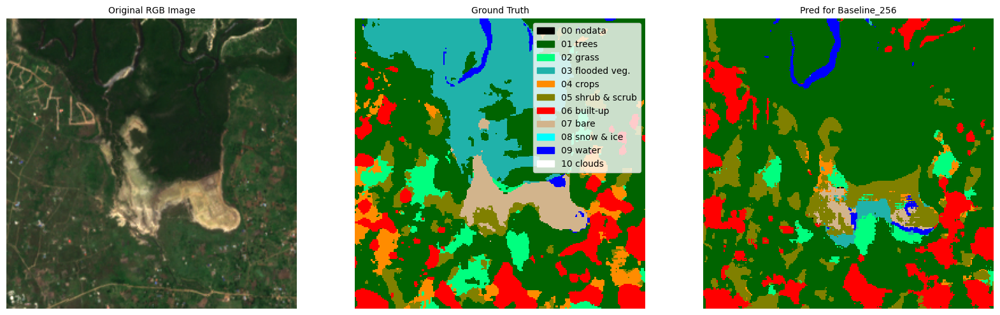

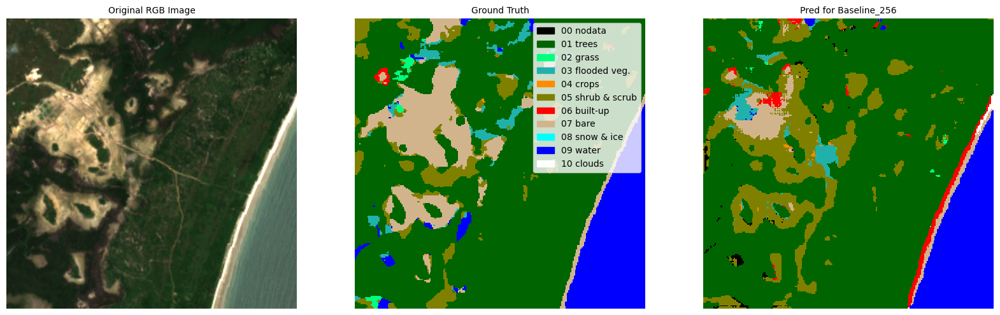

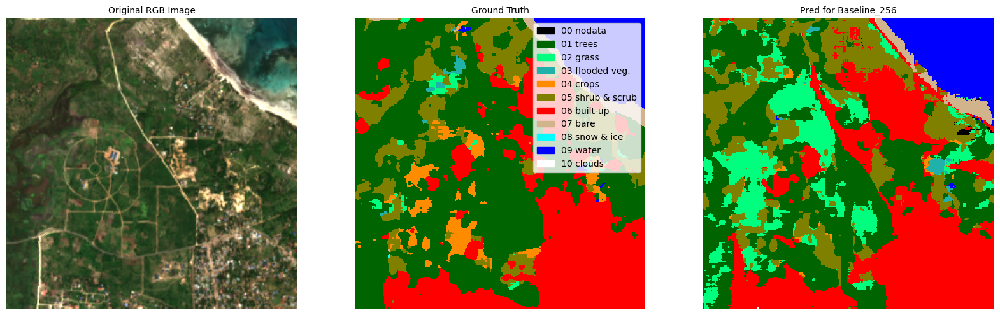

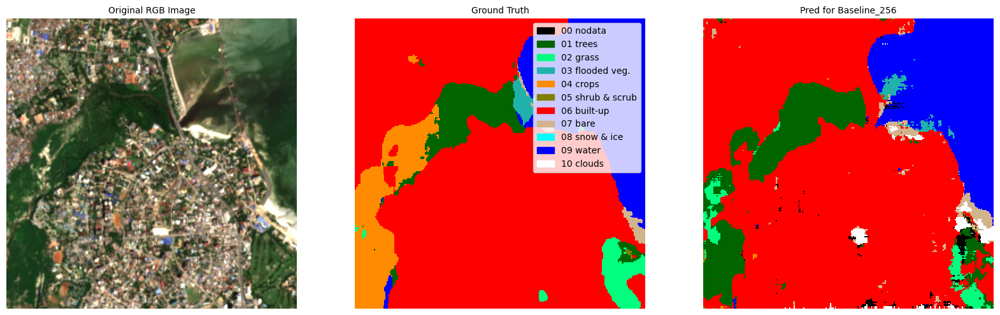

In [38]:
saved_f1 = 0.58
PATH = f"saved_models/NoFusionCNN_bestf1_{saved_f1}.pth"
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

for i in [3853, 6439, 4157, 2180, 21745]:
    rgb = test_dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = test_dataset_no_fusion_256[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, test_dataset_no_fusion_256, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['Baseline_256'])

#### 5.2.3 No fusion model weighted

In [42]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 4 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 16
test_dataloader = DataLoader(test_dataset_no_fusion_256, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 3.0, 0.5, 1.5, 5.0, 0.05, 1.0, 0.25]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.58
PATH = f"saved_models/NoFusionCNN_weighted_bestf1_{saved_f1}.pth"
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)


# store test results
test_results = {
    "test_accuracy": 0.0,
    "test_f1_score": 0.0,
    "test_recall": 0.0,
    "test_precision": 0.0,
}

test_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Test model
_, running_test_confusion_matrix = validate_model(model, criterion, test_dataloader, device, NUM_CLASSES, class_labels)
running_test_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_test_confusion_matrix, exlude_classes)

# Update best f1 scores per class
test_precision, test_recall, test_f1_score = calculate_metrics(running_test_confusion_matrix_reduced)

for i, f1 in enumerate(test_f1_score):
    test_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
test_precision_avg = test_precision.mean()
test_recall_avg = test_recall.mean()
test_f1_score_avg = test_f1_score.mean()
test_accuracy = running_test_confusion_matrix_reduced.trace() / running_test_confusion_matrix.sum()

# Update results lists
test_results["test_accuracy"] = test_accuracy
test_results["test_precision"] = test_precision_avg
test_results["test_recall"] = test_recall_avg
test_results["test_f1_score"] = test_f1_score_avg

cuda


Test accuracy: 0.4627
Test precision: 0.6029
Test recall: 0.6441
Test f1 score: 0.5751
Test f1 score - class 01: 0.7420 (trees)
Test f1 score - class 02: 0.3663 (grass)
Test f1 score - class 03: 0.4053 (flooded veg.)
Test f1 score - class 04: 0.1689 (crops)
Test f1 score - class 05: 0.5447 (shrub & scrub)
Test f1 score - class 06: 0.8225 (built-up)
Test f1 score - class 07: 0.5591 (bare)
Test f1 score - class 09: 0.9922 (water)
Confusion matrix for all relevant classes


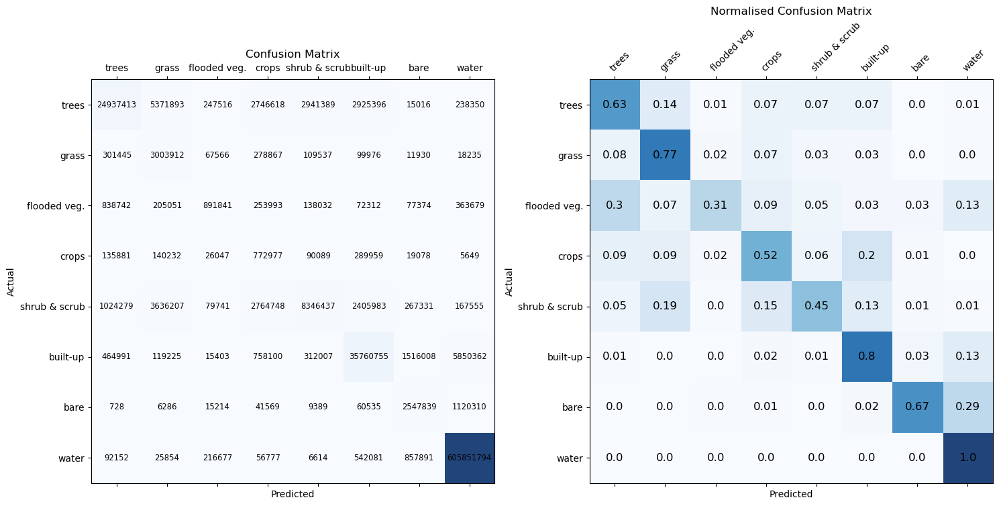

Confusion matrix for all classes


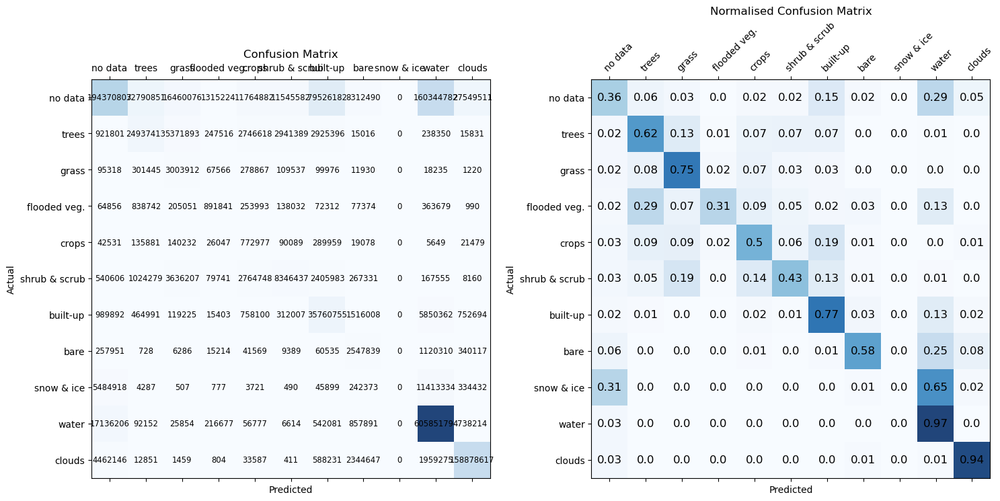

In [43]:
# Print best model metrics
print(f"Test accuracy: {test_results['test_accuracy']:.4f}")
print(f"Test precision: {test_results['test_precision']:.4f}")
print(f"Test recall: {test_results['test_recall']:.4f}")
print(f"Test f1 score: {test_results['test_f1_score']:.4f}")

print(f"Test f1 score - class 01: {test_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Test f1 score - class 02: {test_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Test f1 score - class 03: {test_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Test f1 score - class 04: {test_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Test f1 score - class 05: {test_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Test f1 score - class 06: {test_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Test f1 score - class 07: {test_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Test f1 score - class 09: {test_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_test_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_test_confusion_matrix, labels_all)

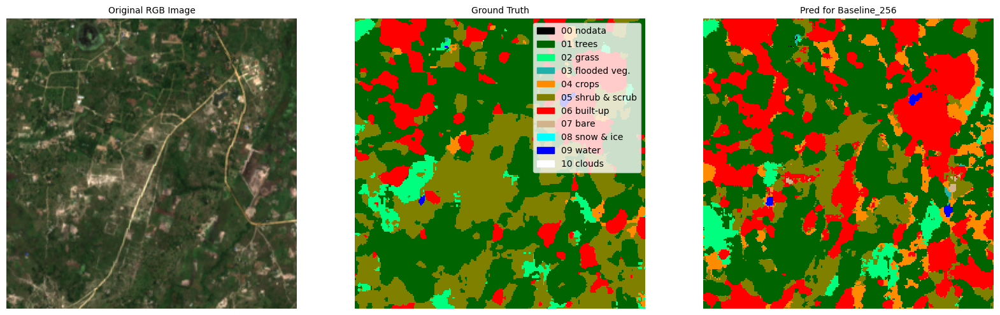

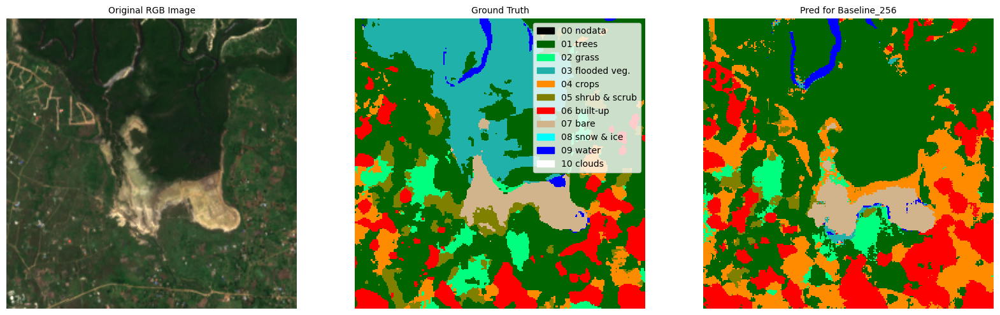

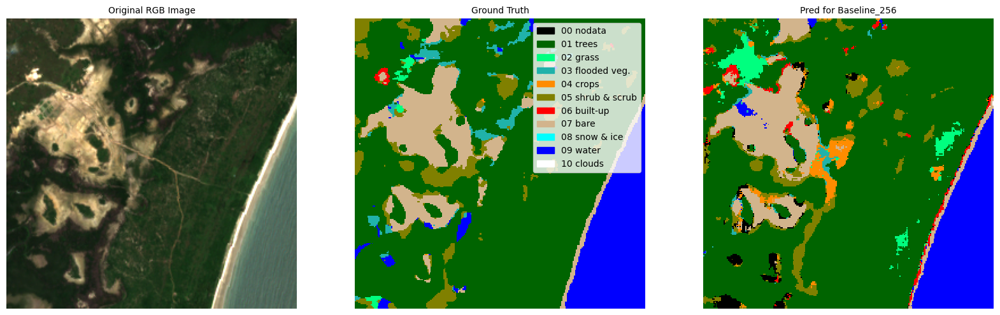

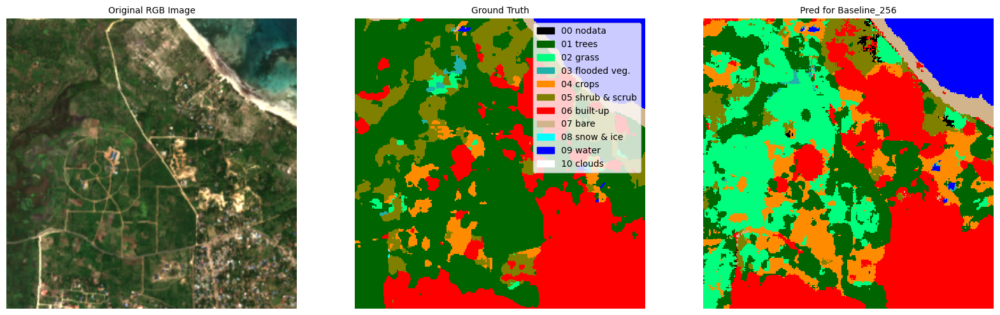

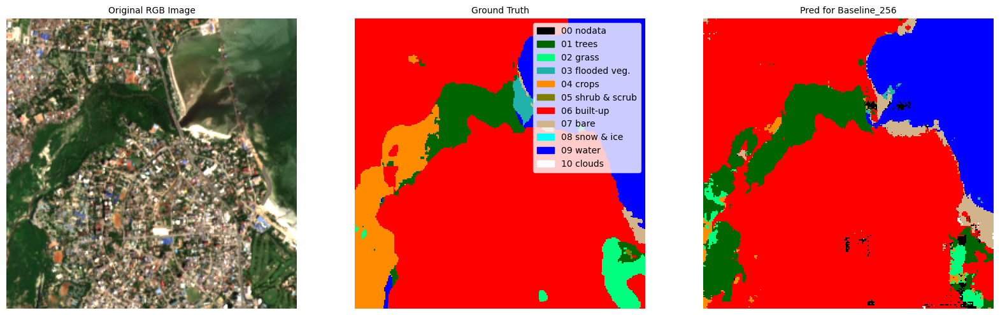

In [39]:
saved_f1 = 0.58
PATH = f"saved_models/NoFusionCNN_weighted_bestf1_{saved_f1}.pth"
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

for i in [3853, 6439, 4157, 2180, 21745]:
    rgb = test_dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = test_dataset_no_fusion_256[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, test_dataset_no_fusion_256, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES, predictions=[pred], model_names = ['Baseline_256'])

#### 5.2.4 Early fusion model 3 time steps

In [46]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

# Define hyperparameters and classes
NUM_CHANNELS = 12 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11
class_labels = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # 0-10
exlude_classes = [0, 8, 10] #8: snow & ice, 10: clouds
reduced_classes = [1, 2, 3, 4, 5, 6, 7, 9] #1: trees, 2: grass, 3: flooded veg., 4: crops, 5: shrub & scrub, 6: built-up, 7: bare, 9: water
batch_size_val = 16
test_dataloader = DataLoader(test_dataset_earlyfusion_256_3, batch_size=batch_size_val, shuffle=False, num_workers=8)
weights = torch.tensor([0.05, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.05, 1.0, 1.0]).to(device) 
criterion = nn.CrossEntropyLoss(weight=weights)

# load model
saved_f1 = 0.58
PATH = f"saved_models/EarlyFusionCNN3_bestf1_{saved_f1}.pth"
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES)
model.to(device)

# store test results
test_results = {
    "test_accuracy": 0.0,
    "test_f1_score": 0.0,
    "test_recall": 0.0,
    "test_precision": 0.0,
}

test_f1_scores_per_class = {f'class{i}': -1 for i in reduced_classes}


# Test model
_, running_test_confusion_matrix = validate_model(model, criterion, test_dataloader, device, NUM_CLASSES, class_labels)
running_test_confusion_matrix_reduced = calculate_reduced_confusion_matrix(running_test_confusion_matrix, exlude_classes)

# Update best f1 scores per class
test_precision, test_recall, test_f1_score = calculate_metrics(running_test_confusion_matrix_reduced)

for i, f1 in enumerate(test_f1_score):
    test_f1_scores_per_class[f'class{i}'] = f1

# Calculate average metrics
test_precision_avg = test_precision.mean()
test_recall_avg = test_recall.mean()
test_f1_score_avg = test_f1_score.mean()
test_accuracy = running_test_confusion_matrix_reduced.trace() / running_test_confusion_matrix.sum()

# Update results lists
test_results["test_accuracy"] = test_accuracy
test_results["test_precision"] = test_precision_avg
test_results["test_recall"] = test_recall_avg
test_results["test_f1_score"] = test_f1_score_avg

cuda


Test accuracy: 0.4313
Test precision: 0.5257
Test recall: 0.5115
Test f1 score: 0.5111
Test f1 score - class 01: 0.7366 (trees)
Test f1 score - class 02: 0.3436 (grass)
Test f1 score - class 03: 0.2683 (flooded veg.)
Test f1 score - class 04: 0.1023 (crops)
Test f1 score - class 05: 0.5804 (shrub & scrub)
Test f1 score - class 06: 0.7660 (built-up)
Test f1 score - class 07: 0.3015 (bare)
Test f1 score - class 09: 0.9898 (water)
Confusion matrix for all relevant classes


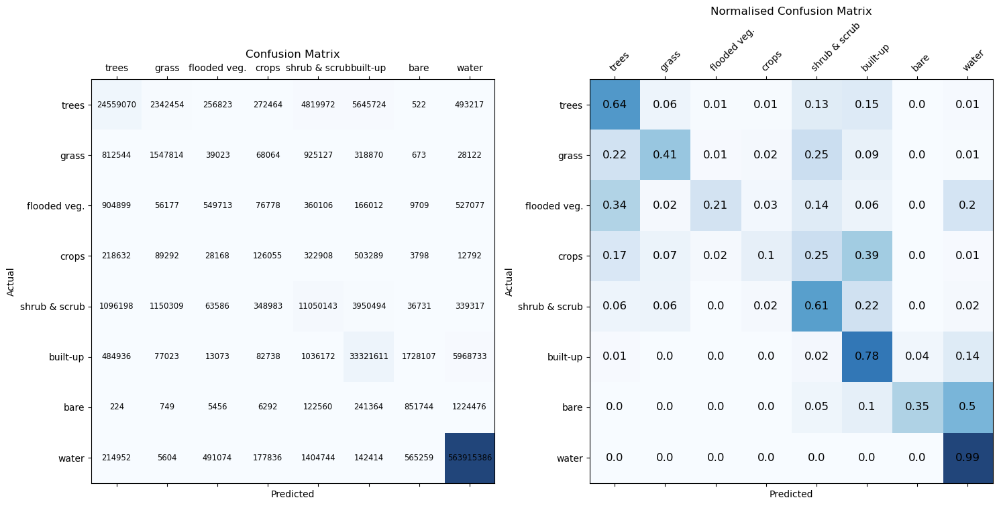

Confusion matrix for all classes


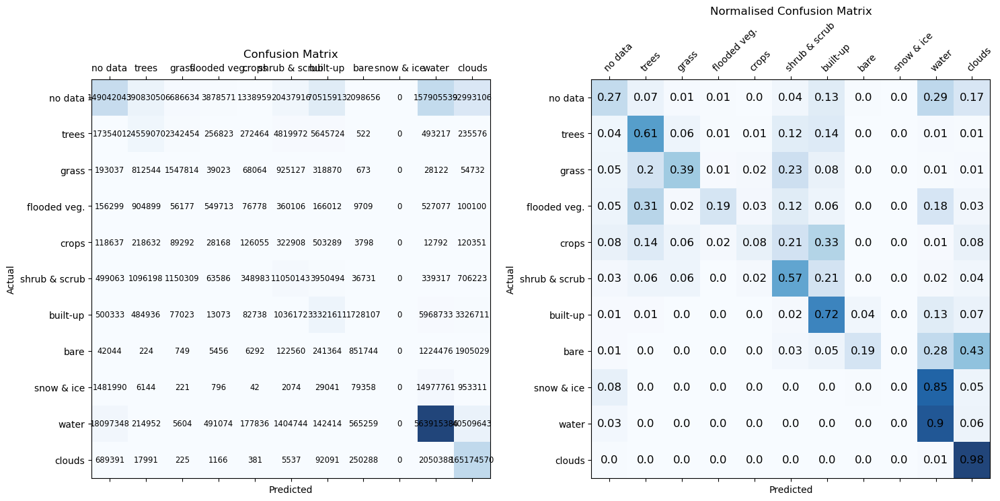

In [47]:
# Print best model metrics
print(f"Test accuracy: {test_results['test_accuracy']:.4f}")
print(f"Test precision: {test_results['test_precision']:.4f}")
print(f"Test recall: {test_results['test_recall']:.4f}")
print(f"Test f1 score: {test_results['test_f1_score']:.4f}")

print(f"Test f1 score - class 01: {test_f1_scores_per_class['class0']:.4f} (trees)")
print(f"Test f1 score - class 02: {test_f1_scores_per_class['class1']:.4f} (grass)")
print(f"Test f1 score - class 03: {test_f1_scores_per_class['class2']:.4f} (flooded veg.)")
print(f"Test f1 score - class 04: {test_f1_scores_per_class['class3']:.4f} (crops)")
print(f"Test f1 score - class 05: {test_f1_scores_per_class['class4']:.4f} (shrub & scrub)")
print(f"Test f1 score - class 06: {test_f1_scores_per_class['class5']:.4f} (built-up)")
print(f"Test f1 score - class 07: {test_f1_scores_per_class['class6']:.4f} (bare)")
print(f"Test f1 score - class 09: {test_f1_scores_per_class['class7']:.4f} (water)")

labels_all = ["no data", "trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "snow & ice", "water", "clouds"]
labels_reduced = ["trees", "grass", "flooded veg.", "crops", "shrub & scrub", "built-up", "bare", "water"]

print("Confusion matrix for all relevant classes")
plot_conf_matrix_multiclass(running_test_confusion_matrix_reduced, labels_reduced)
print("Confusion matrix for all classes")
plot_conf_matrix_multiclass(running_test_confusion_matrix, labels_all)

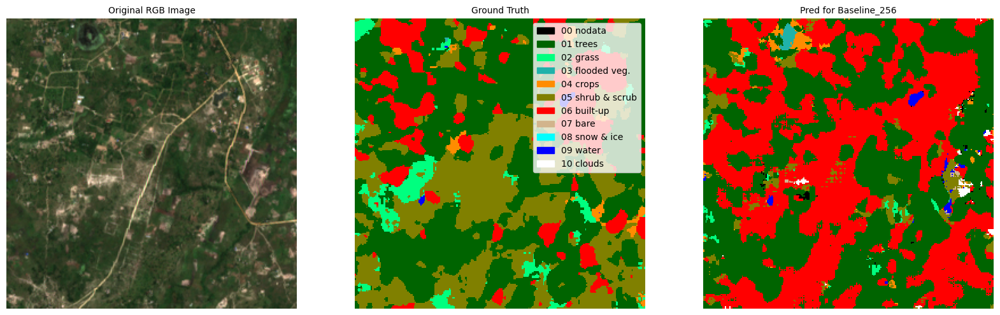

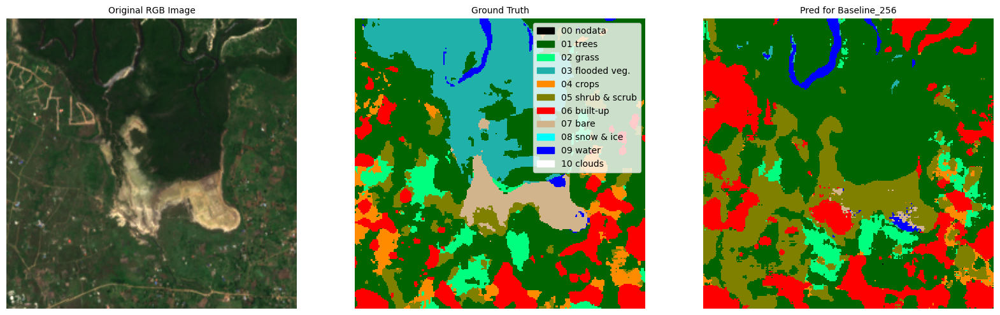

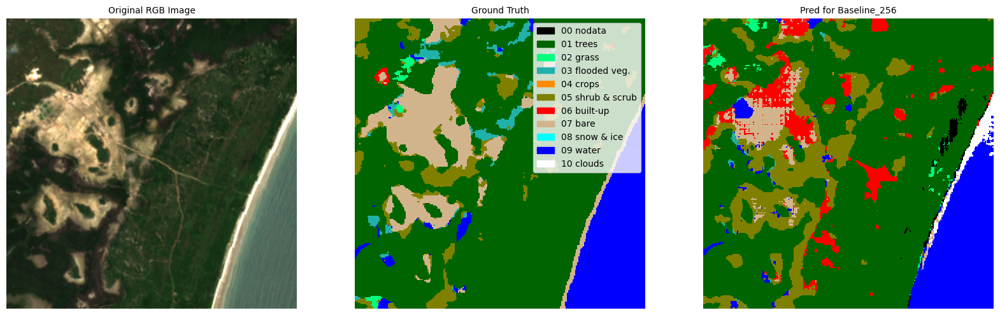

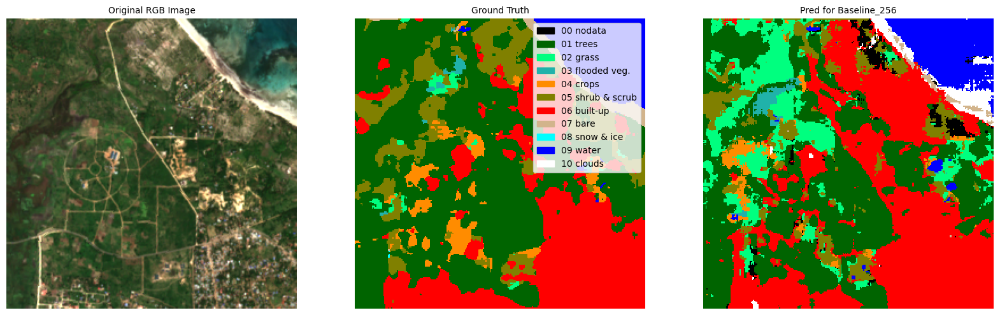

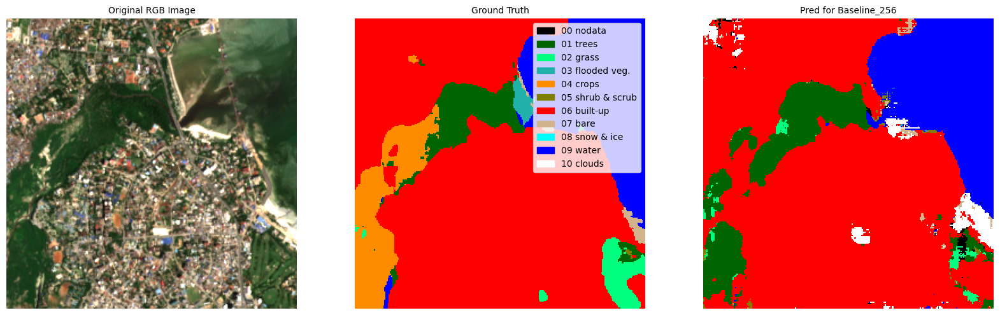

In [40]:
NUM_CHANNELS = 12 # input dimension: 4 channels (R, G, B, NIR)
NUM_CLASSES = 11

saved_f1 = 0.58
PATH = f"saved_models/EarlyFusionCNN3_bestf1_{saved_f1}.pth"
model = load_model(Unet_DW, PATH, device, NUM_CHANNELS, NUM_CLASSES )
model.to(device)

for i in [3853, 6439, 4157, 2180, 21745]:
    rgb = test_dataset_separated[i][0].permute(1, 2, 0).numpy()
    truth = test_dataset_earlyfusion_256_3[i][1].squeeze(0).cpu().numpy()
    pred = predict_on_patch(model, test_dataset_earlyfusion_256_3, i, device)
    plot_dw_with_overlays(rgb, truth, NUM_CLASSES , predictions=[pred], model_names = ['Baseline_256'])